C:\Users\20301002\AppData\Local\Programs\Python\Python312\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\20301002\AppData\Local\Programs\Python\Python312\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\20301002\AppData\Local\Programs\Python\Python312\Lib\site-packages\torch\optim\lr_scheduler.py:60: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch [1/500], Generator Loss: 0.7484484747052192, Discriminator Loss: 0.7203623227775097, Validation Loss: 0.6816521000117064
Epoch [2/500], Generator Loss: 0.677329245209694, Discriminator Loss: 0.6817874483764171, Validation Loss: 0.64437077017501
Epoch [3/500], Generator Loss: 0.6547144688665867, Discriminator Loss: 0.6851417727768421, Validation Loss: 0.6301799590699375
Epoch [4/500], Generator Loss: 0.6410585418343544, Discriminator Loss: 0.6653701979666948, Validation Loss: 0.6105020356364548
Epoch [5/500], Generator Loss: 0.6170479215681552, Discriminator Loss: 0.6580806203186512, Validation Loss: 0.5961176645942032
Epoch [6/500], Generator Loss: 0.5996528074145318, Discriminator Loss: 0.8728590375743807, Validation Loss: 0.5658881986048072
Epoch [7/500], Generator Loss: 0.5784395538270474, Discriminator Loss: 0.6920279286801815, Validation Loss: 0.5448073614388704
Epoch [8/500], Generator Loss: 0.5669694367796183, Discriminator Loss: 0.6969713170081377, Validation Loss: 0.5384

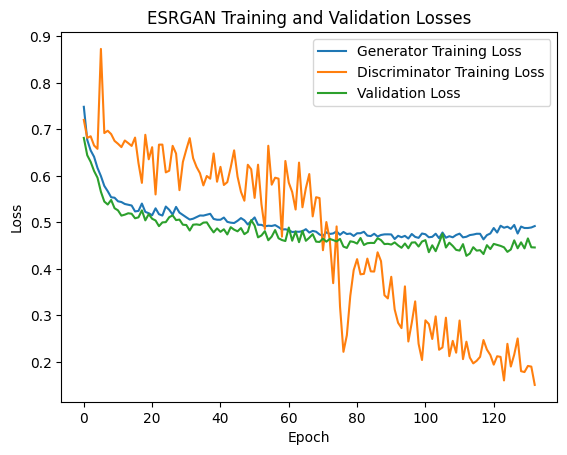

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import os
import cv2
import numpy as np
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import torchvision.models as models
import random
from torch.optim.lr_scheduler import ReduceLROnPlateau

# Define the Residual Dense Block (RDB) class
class ResidualDenseBlock(nn.Module):
    def __init__(self, nf, gc=32, bias=True):
        super(ResidualDenseBlock, self).__init__()
        self.conv1 = nn.Conv2d(nf, gc, 3, 1, 1, bias=bias)
        self.conv2 = nn.Conv2d(nf + gc, gc, 3, 1, 1, bias=bias)
        self.conv3 = nn.Conv2d(nf + 2 * gc, gc, 3, 1, 1, bias=bias)
        self.conv4 = nn.Conv2d(nf + 3 * gc, gc, 3, 1, 1, bias=bias)
        self.conv5 = nn.Conv2d(nf + 4 * gc, nf, 3, 1, 1, bias=bias)

        self.lrelu = nn.LeakyReLU(negative_slope=0.2, inplace=True)
        self.prelu = nn.PReLU()


    def forward(self, x):
        x1 = self.lrelu(self.conv1(x))
        x2 = self.prelu(self.conv2(torch.cat((x, x1), 1)))
        x3 = self.lrelu(self.conv3(torch.cat((x, x1, x2), 1)))
        x4 = self.prelu(self.conv4(torch.cat((x, x1, x2, x3), 1)))
        x5 = self.conv5(torch.cat((x, x1, x2, x3, x4), 1))
        return x5 * 0.2 + x

# Define the Residual in Residual Dense Block (RRDB) class
class RRDB(nn.Module):
    def __init__(self, nf, gc=32, bias=True):
        super(RRDB, self).__init__()
        self.RDB1 = ResidualDenseBlock(nf, gc, bias)
        self.RDB2 = ResidualDenseBlock(nf, gc, bias)
        self.RDB3 = ResidualDenseBlock(nf, gc, bias)

    def forward(self, x):
        out = self.RDB1(x)
        out = self.RDB2(out)
        out = self.RDB3(out)
        return out + x

# Define the generator network for MSRGAN
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.RRDB_blocks = nn.Sequential(
            RRDB(64),
            RRDB(64),
            RRDB(64)
        )
        self.conv3 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.conv4 = nn.Conv2d(64, 3, kernel_size=3, padding=1)

        self.lrelu = nn.LeakyReLU(negative_slope=0.2, inplace=True)
        self.prelu = nn.PReLU()

    def forward(self, x):
        # Using PReLU after the first conv layer
        x1 = self.prelu(self.conv1(x))
        # Using LeakyReLU after the second conv layer
        x2 = self.lrelu(self.conv2(x1))
        # Passing through RRDB blocks
        x = self.RRDB_blocks(x2)
        # Using PReLU after conv3
        x = self.prelu(self.conv3(x))
        # Output layer without activation
        x = self.conv4(x)
        return x

# Define the discriminator network for MSRGAN
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(64, 64, kernel_size=3, stride=2, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.conv4 = nn.Conv2d(128, 128, kernel_size=3, stride=2, padding=1)
        self.conv5 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.conv6 = nn.Conv2d(256, 256, kernel_size=3, stride=2, padding=1)
        self.conv7 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.conv8 = nn.Conv2d(512, 512, kernel_size=3, stride=2, padding=1)
        self.fc1 = nn.Linear(512 * 8 * 8, 1024)
        self.fc2 = nn.Linear(1024, 1)
        self.leaky_relu = nn.LeakyReLU(0.2)
        self.prelu = nn.PReLU()
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        # LeakyReLU for conv1
        x = self.leaky_relu(self.conv1(x))
        # PReLU for conv2
        x = self.prelu(self.conv2(x))
        # LeakyReLU for conv3
        x = self.leaky_relu(self.conv3(x))
        # PReLU for conv4
        x = self.prelu(self.conv4(x))
        # LeakyReLU for conv5
        x = self.leaky_relu(self.conv5(x))
        # PReLU for conv6
        x = self.prelu(self.conv6(x))
        # LeakyReLU for conv7
        x = self.leaky_relu(self.conv7(x))
        # PReLU for conv8
        x = self.prelu(self.conv8(x))
        # Flatten the tensor before fully connected layers
        x = x.view(x.size(0), -1)
        # LeakyReLU for fully connected layer 1
        x = self.leaky_relu(self.fc1(x))
        # Output layer
        x = self.fc2(x)
        return x


# Prepare the dataset and data loaders
class CustomDataset(Dataset):
    def __init__(self, root_dir, high_res_size, low_res_size, is_train=True, blur_prob=0.5, train_val_split=0.8):
        self.root_dir = root_dir
        self.high_res_dir = os.path.join(root_dir, 'high_res')
        self.low_res_dir = os.path.join(root_dir, 'low_res')
        self.high_res_images = os.listdir(self.high_res_dir)
        self.high_res_size = high_res_size
        self.low_res_size = low_res_size
        self.is_train = is_train
        self.blur_prob = blur_prob
        self.train_val_split = train_val_split
        self.train_high_res_images, self.val_high_res_images = self._split_train_val()

    def __len__(self):
        if self.is_train:
            return len(self.train_high_res_images)
        else:
            return len(self.val_high_res_images)

    def _split_train_val(self):
        random.shuffle(self.high_res_images)
        split_idx = int(len(self.high_res_images) * self.train_val_split)
        train_images = self.high_res_images[:split_idx]
        val_images = self.high_res_images[split_idx:]
        return train_images, val_images

    def __getitem__(self, idx):
        if self.is_train:
            img_name = self.train_high_res_images[idx]
        else:
            img_name = self.val_high_res_images[idx]
        high_res_img_path = os.path.join(self.high_res_dir, img_name)
        low_res_img_path = os.path.join(self.low_res_dir, img_name)

        high_res_img = cv2.imread(high_res_img_path)
        low_res_img = cv2.imread(low_res_img_path)

        if high_res_img is None:
            raise FileNotFoundError(f"High-res image file '{high_res_img_path}' not found.")
        if low_res_img is None:
            raise FileNotFoundError(f"Low-res image file '{low_res_img_path}' not found.")

        # Resize images
        high_res_img = cv2.resize(high_res_img, self.high_res_size)
        low_res_img = cv2.resize(low_res_img, self.low_res_size)

        # Blur preprocessing for training data
        if self.is_train and random.random() < self.blur_prob:
            low_res_img = cv2.GaussianBlur(low_res_img, (5, 5), 0)

        high_res_img = transforms.ToTensor()(high_res_img)
        low_res_img = transforms.ToTensor()(low_res_img)
        return high_res_img, low_res_img

# Define the training loop for MSRGAN
def train_msrgan(generator, discriminator, train_loader, val_loader, content_loss, criterion_adversarial, optimizer_generator, optimizer_discriminator, scheduler, num_epochs=100, patience=20):
    generator.train()
    discriminator.train()
    generator_losses = []
    discriminator_losses = []
    val_losses = []
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    best_val_loss = float('inf')
    counter = 0
    best_generator_state = None

    for epoch in range(num_epochs):
        gen_running_loss = 0.0
        disc_running_loss = 0.0

        for i, (high_res_img, low_res_img) in enumerate(train_loader):
            high_res_img, low_res_img = high_res_img.to(device), low_res_img.to(device)

            # Training generator
            optimizer_generator.zero_grad()
            fake_hr_img = generator(low_res_img)
            real_features = resnet_model(high_res_img).detach()  # Detach to avoid gradient computation
            fake_features = resnet_model(fake_hr_img)
            gen_loss_content = content_loss(fake_features, real_features)
            fake_pred = discriminator(fake_hr_img)
            gen_loss_adversarial = criterion_adversarial(fake_pred, torch.ones_like(fake_pred))
            gen_loss = gen_loss_content + 0.01 * gen_loss_adversarial  # Updated adversarial loss weight
            gen_loss.backward()
            optimizer_generator.step()
            gen_running_loss += gen_loss.item()

            # Training discriminator
            optimizer_discriminator.zero_grad()
            real_pred = discriminator(high_res_img)
            fake_pred = discriminator(fake_hr_img.detach())
            disc_loss_real = criterion_adversarial(real_pred, torch.ones_like(real_pred))
            disc_loss_fake = criterion_adversarial(fake_pred, torch.zeros_like(fake_pred))
            disc_loss = 0.5 * (disc_loss_real + disc_loss_fake)
            disc_loss.backward()
            optimizer_discriminator.step()
            disc_running_loss += disc_loss.item()

        epoch_gen_loss = gen_running_loss / len(train_loader)
        epoch_disc_loss = disc_running_loss / len(train_loader)
        generator_losses.append(epoch_gen_loss)
        discriminator_losses.append(epoch_disc_loss)

        # Validation phase
        val_loss = 0.0
        with torch.no_grad():
            for high_res_img, low_res_img in val_loader:
                high_res_img, low_res_img = high_res_img.to(device), low_res_img.to(device)
                fake_hr_img = generator(low_res_img)
                val_loss += content_loss(resnet_model(fake_hr_img), resnet_model(high_res_img)).item()
            val_loss /= len(val_loader)
            val_losses.append(val_loss)

        print(f'Epoch [{epoch+1}/{num_epochs}], Generator Loss: {epoch_gen_loss}, Discriminator Loss: {epoch_disc_loss}, Validation Loss: {val_loss}')

        # Learning rate scheduler step
        scheduler.step(val_loss)

        # Early stopping based on generator loss
        if epoch == 0 or val_loss < best_val_loss:
            best_val_loss = val_loss
            counter = 0
            best_generator_state = generator.state_dict()
        else:
            counter += 1
            if counter >= patience:
                print(f'Generator loss did not improve for {patience} epochs. Early stopping...')
                break

    # Load the best generator state
    generator.load_state_dict(best_generator_state)

    return generator_losses, discriminator_losses, val_losses

# Define dataset paths and image sizes
train_dataset = CustomDataset(root_dir=r'furniture\train', high_res_size=(128, 128), low_res_size=(128, 128), is_train=True)
val_dataset = CustomDataset(root_dir=r'furniture\train', high_res_size=(128, 128), low_res_size=(128, 128), is_train=False)
test_dataset = CustomDataset(root_dir=r'furniture\test', high_res_size=(128, 128), low_res_size=(128, 128), is_train=False)

# Define data loaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=1, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

# Initialize generator and discriminator
generator = Generator()
discriminator = Discriminator()

# Move models to appropriate device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
discriminator.to(device)

# Define loss functions
criterion_adversarial = nn.BCEWithLogitsLoss()

# Load pre-trained ResNet-18 model
resnet_model = models.resnet18(pretrained=True).eval().to(device)

# Modify the model to use only features
resnet_model = nn.Sequential(*list(resnet_model.children())[:-1]).to(device)

# Define content loss function using features from ResNet
content_loss = nn.L1Loss()

# Define optimizers for generator and discriminator
optimizer_generator = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.9, 0.999))
optimizer_discriminator = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.9, 0.999))

# Learning rate scheduler
scheduler = ReduceLROnPlateau(optimizer_generator, mode='min', factor=0.5, patience=20, verbose=True)

# Train MSRGAN
gen_losses, disc_losses, val_losses = train_msrgan(generator, discriminator, train_loader, val_loader, content_loss, criterion_adversarial, optimizer_generator, optimizer_discriminator, scheduler, num_epochs=500)

# Plot the losses
plt.plot(gen_losses, label='Generator Training Loss')
plt.plot(disc_losses, label='Discriminator Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('MSRGAN Training and Validation Losses')
plt.legend()
plt.show()

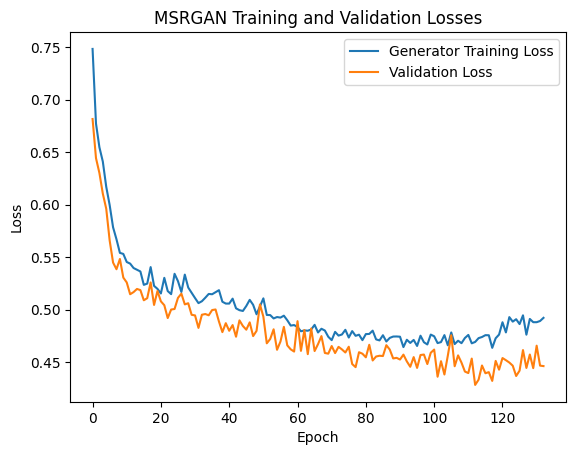

In [ ]:
plt.plot(gen_losses, label='Generator Training Loss')
#plt.plot(disc_losses, label='Discriminator Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('MSRGAN Training and Validation Losses')
plt.legend()
plt.show()

Calculating PSNR and SSIM: 100%|█████████████████████████████████████████████████████| 320/320 [00:04<00:00, 76.08it/s]


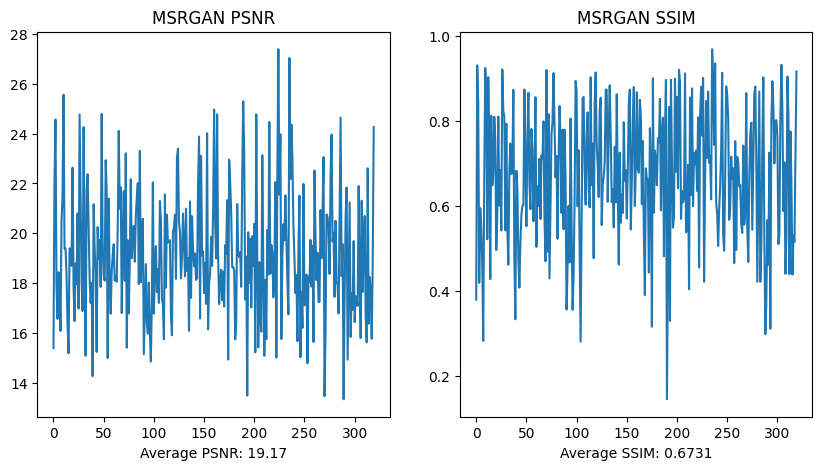

Average PSNR: 19.17
Average SSIM: 0.6731


In [ ]:
import torch
import torchvision
from skimage.metrics import peak_signal_noise_ratio, structural_similarity
from tqdm import tqdm
import matplotlib.pyplot as plt

def calculate_psnr_ssim(generator, test_loader, device):
    generator.eval()
    psnr_values = []
    ssim_values = []

    with torch.no_grad():
        for high_res_img, low_res_img in tqdm(val_loader, desc="Calculating PSNR and SSIM"):
            high_res_img, low_res_img = high_res_img.to(device), low_res_img.to(device)
            fake_hr_img = generator(low_res_img).clamp(0, 1)

            # Convert to numpy arrays
            fake_hr_np = fake_hr_img.cpu().detach().numpy().transpose(0, 2, 3, 1)  # (N, C, H, W) -> (N, H, W, C)
            high_res_np = high_res_img.cpu().detach().numpy().transpose(0, 2, 3, 1)

            # Calculate PSNR and SSIM
            for i in range(len(fake_hr_np)):
                psnr = peak_signal_noise_ratio(high_res_np[i], fake_hr_np[i])
                ssim = structural_similarity(high_res_np[i], fake_hr_np[i], win_size=3, multichannel=True, data_range=1)  # Specify data_range
                psnr_values.append(psnr)
                ssim_values.append(ssim)

    avg_psnr = sum(psnr_values) / len(psnr_values)
    avg_ssim = sum(ssim_values) / len(ssim_values)

    return avg_psnr, avg_ssim, psnr_values, ssim_values

# Calculate PSNR and SSIM
avg_psnr, avg_ssim, psnr_values, ssim_values = calculate_psnr_ssim(generator, test_loader, device)

# Plot PSNR and SSIM
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(psnr_values)
plt.title('MSRGAN PSNR')
#plt.xlabel('MSRGAN')
plt.xlabel(f'Average PSNR: {avg_psnr:.2f}')
plt.subplot(1, 2, 2)
plt.plot(ssim_values)
plt.title('MSRGAN SSIM')
#plt.xlabel('MSRGAN')
plt.xlabel(f'Average SSIM: {avg_ssim:.4f}')
plt.show()

print(f'Average PSNR: {avg_psnr:.2f}')
print(f'Average SSIM: {avg_ssim:.4f}')

In [ ]:
# Calculate PSNR and SSIM
avg_psnr, avg_ssim, psnr_values, ssim_values = calculate_psnr_ssim(generator, test_loader, device)

# Find index with highest PSNR and lowest SSIM
highest_psnr_index = psnr_values.index(max(psnr_values))
lowest_ssim_index = ssim_values.index(min(ssim_values))

# Get corresponding PSNR and SSIM values
highest_psnr = psnr_values[highest_psnr_index]
lowest_ssim = ssim_values[lowest_ssim_index]

# Print results
print(f'Highest PSNR: {highest_psnr:.2f} (Image index: {highest_psnr_index})')
print(f'Lowest SSIM: {lowest_ssim:.4f} (Image index: {lowest_ssim_index})')

Calculating PSNR and SSIM: 100%|█████████████████████████████████████████████████████| 320/320 [00:04<00:00, 77.49it/s]

Highest PSNR: 27.39 (Image index: 224)
Lowest SSIM: 0.1455 (Image index: 190)


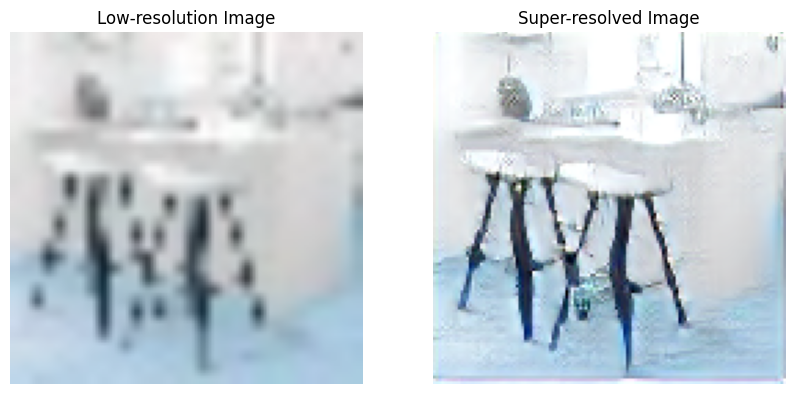

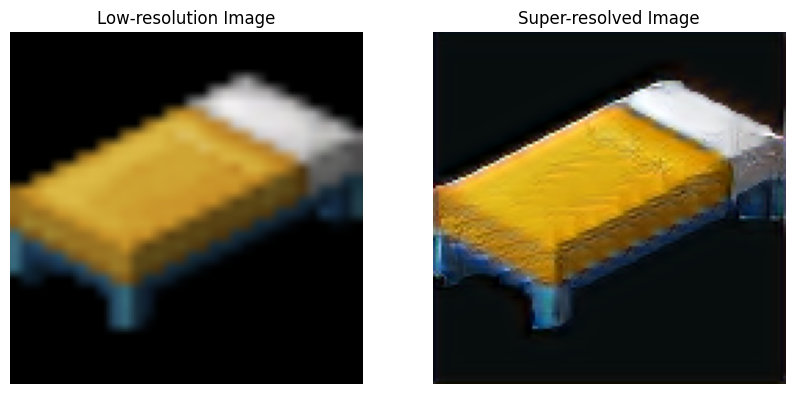

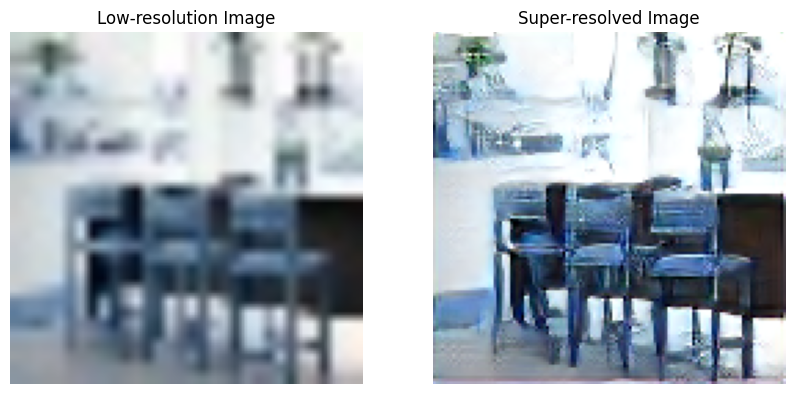

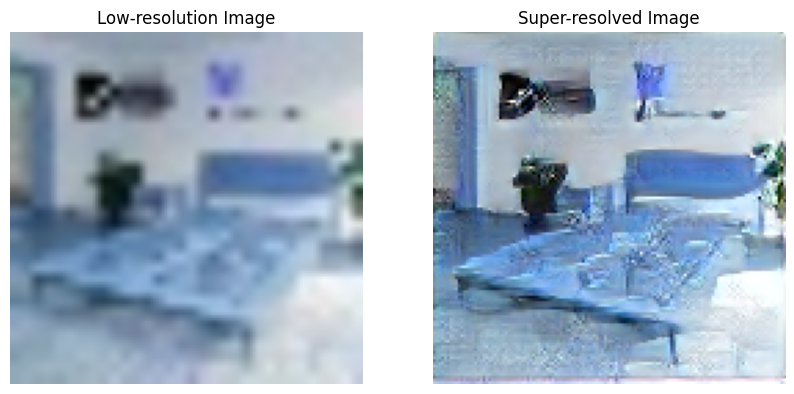

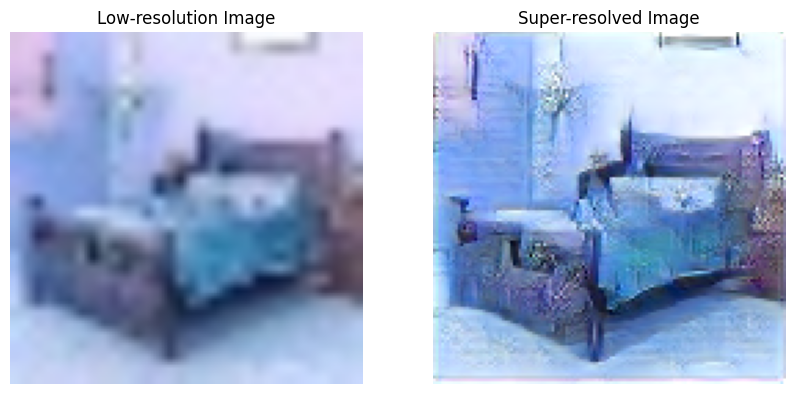

In [ ]:
def sample_super_resolution(generator, test_loader, num_samples=5):
    generator.eval()

    device = next(generator.parameters()).device
    with torch.no_grad():
        for i, (high_res_img, low_res_img) in enumerate(test_loader):
            if i >= num_samples:
                break
            high_res_img, low_res_img = high_res_img.to(device), low_res_img.to(device)
            fake_hr_img = generator(low_res_img)

            # Convert to numpy arrays
            low_res_np = low_res_img.squeeze().permute(1, 2, 0).cpu().numpy()
            fake_hr_np = fake_hr_img.squeeze().permute(1, 2, 0).cpu().numpy()

            # Plot images
            plt.figure(figsize=(10, 5))
            plt.subplot(1, 2, 1)
            plt.imshow(np.clip(low_res_np, 0, 1))
            plt.title('Low-resolution Image')
            plt.axis('off')
            plt.subplot(1, 2, 2)
            plt.imshow(np.clip(fake_hr_np, 0, 1))
            plt.title('Super-resolved Image')
            plt.axis('off')
            plt.show()

# Sample super-resolution images
sample_super_resolution(generator, test_loader, num_samples=5)

Processing images:   0%|                                                                        | 0/80 [00:00<?, ?it/s]

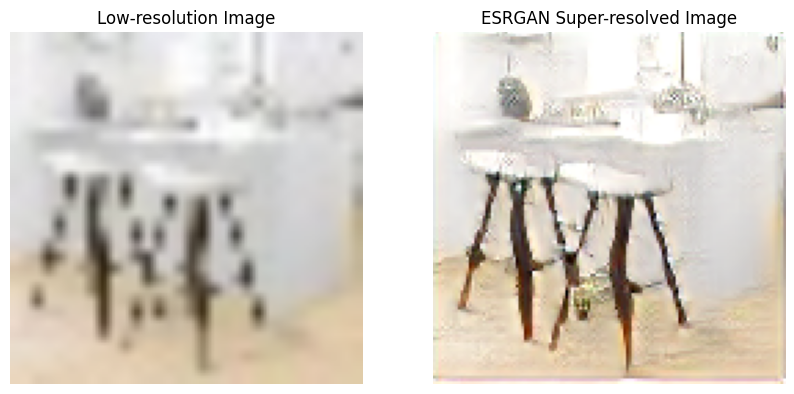

Processing images:   1%|▊                                                               | 1/80 [00:00<00:15,  4.97it/s]

Saved super-resolved image 1 to msrgan_super_res_images\super_res_image_0.png


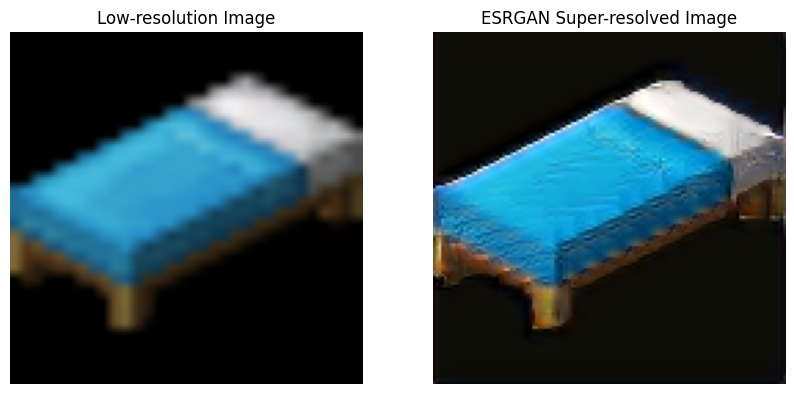

Processing images:   2%|█▌                                                              | 2/80 [00:00<00:13,  5.77it/s]

Saved super-resolved image 2 to msrgan_super_res_images\super_res_image_1.png


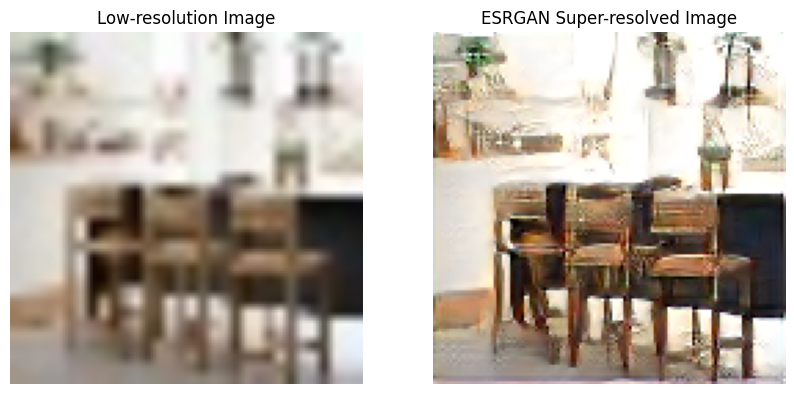

Processing images:   4%|██▍                                                             | 3/80 [00:00<00:14,  5.29it/s]

Saved super-resolved image 3 to msrgan_super_res_images\super_res_image_2.png


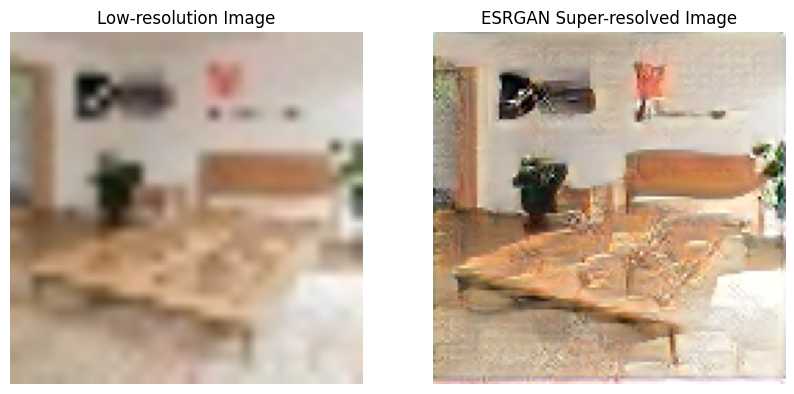

Processing images:   5%|███▏                                                            | 4/80 [00:00<00:14,  5.19it/s]

Saved super-resolved image 4 to msrgan_super_res_images\super_res_image_3.png


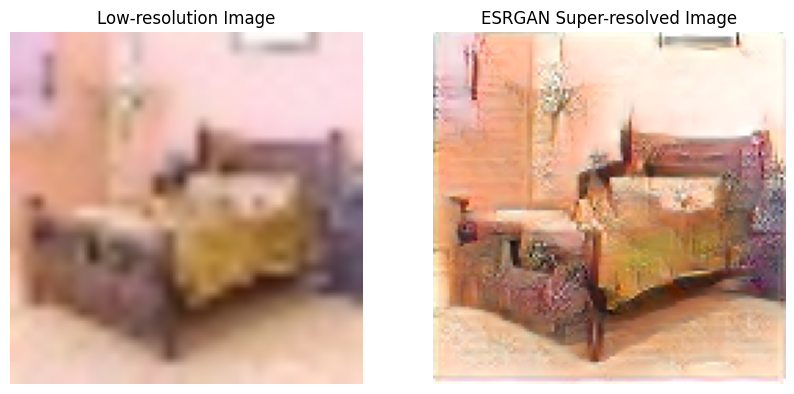

Processing images:   6%|████                                                            | 5/80 [00:00<00:14,  5.07it/s]

Saved super-resolved image 5 to msrgan_super_res_images\super_res_image_4.png


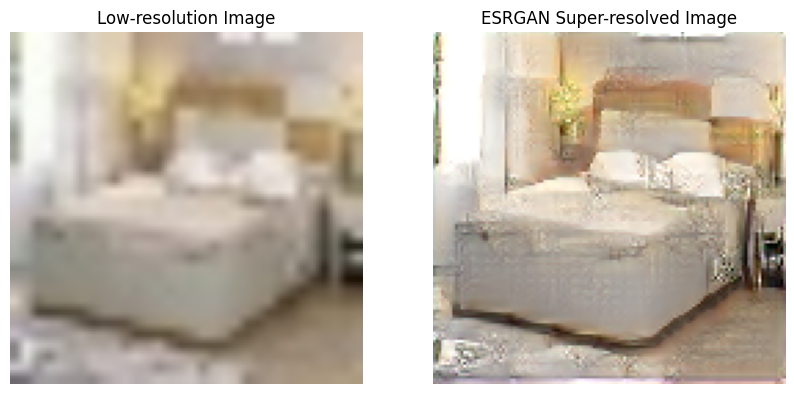

Processing images:   8%|████▊                                                           | 6/80 [00:01<00:14,  5.11it/s]

Saved super-resolved image 6 to msrgan_super_res_images\super_res_image_5.png


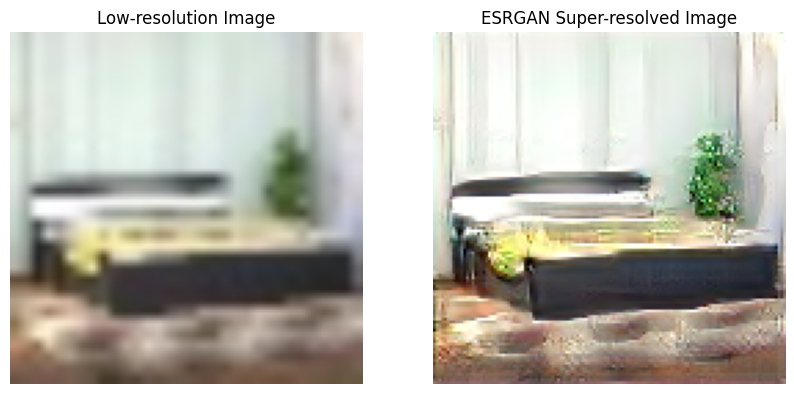

Processing images:   9%|█████▌                                                          | 7/80 [00:01<00:14,  5.18it/s]

Saved super-resolved image 7 to msrgan_super_res_images\super_res_image_6.png


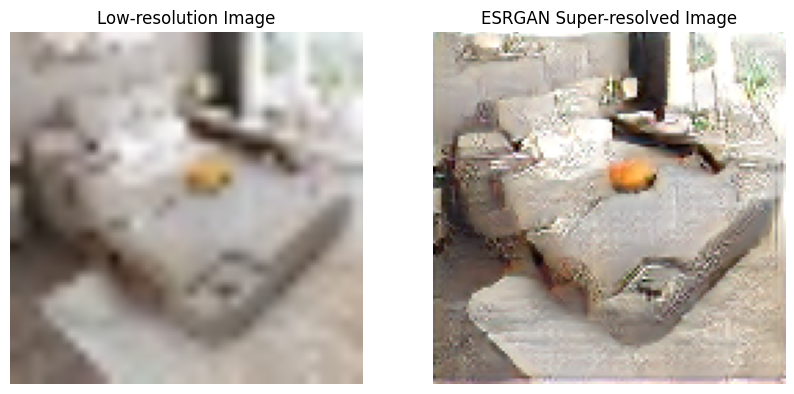

Processing images:  10%|██████▍                                                         | 8/80 [00:01<00:14,  5.14it/s]

Saved super-resolved image 8 to msrgan_super_res_images\super_res_image_7.png


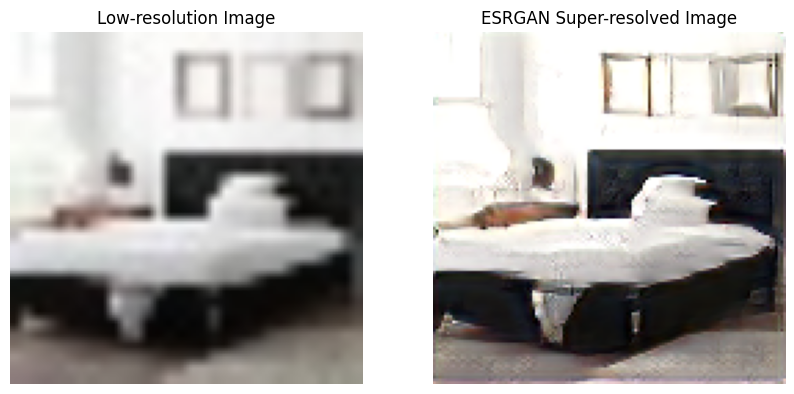

Processing images:  11%|███████▏                                                        | 9/80 [00:01<00:13,  5.30it/s]

Saved super-resolved image 9 to msrgan_super_res_images\super_res_image_8.png


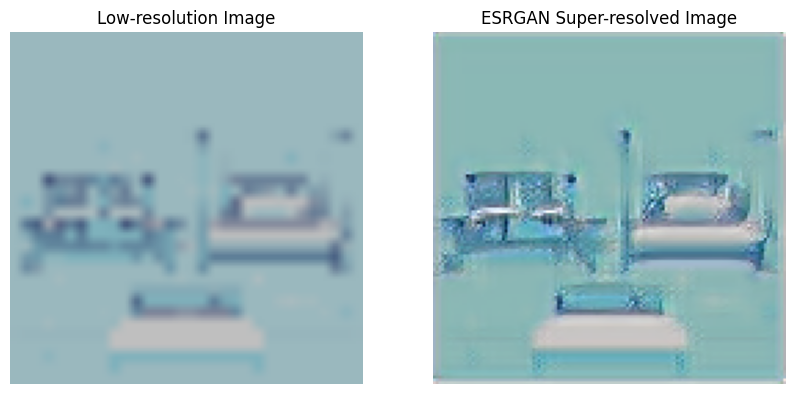

Processing images:  12%|███████▉                                                       | 10/80 [00:01<00:12,  5.70it/s]

Saved super-resolved image 10 to msrgan_super_res_images\super_res_image_9.png


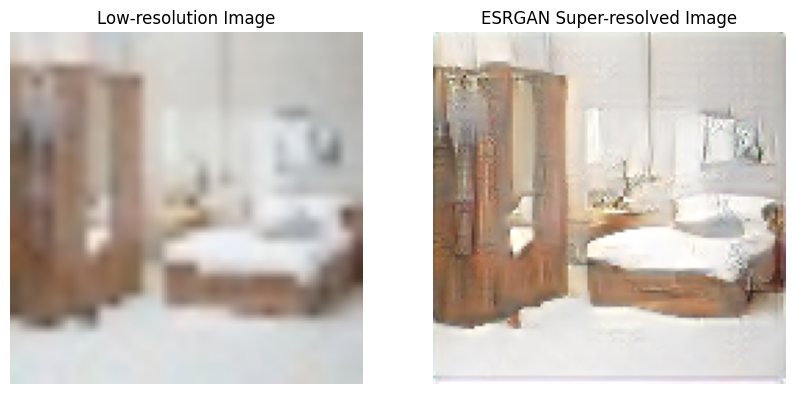

Processing images:  14%|████████▋                                                      | 11/80 [00:02<00:12,  5.58it/s]

Saved super-resolved image 11 to msrgan_super_res_images\super_res_image_10.png


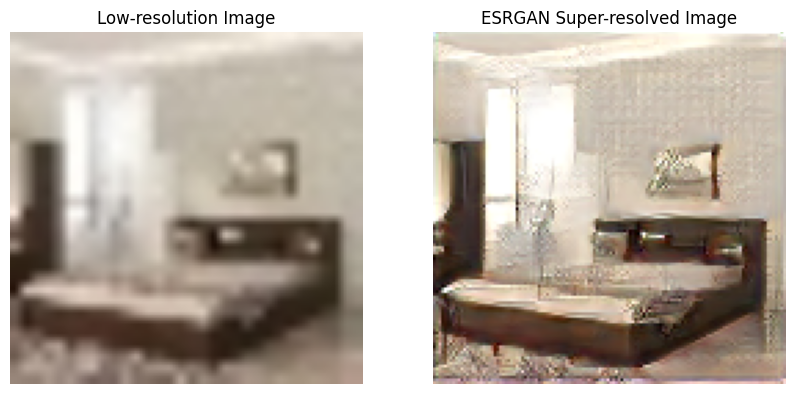

Saved super-resolved image 12 to msrgan_super_res_images\super_res_image_11.png

Processing images:  15%|█████████▍                                                     | 12/80 [00:02<00:12,  5.51it/s]

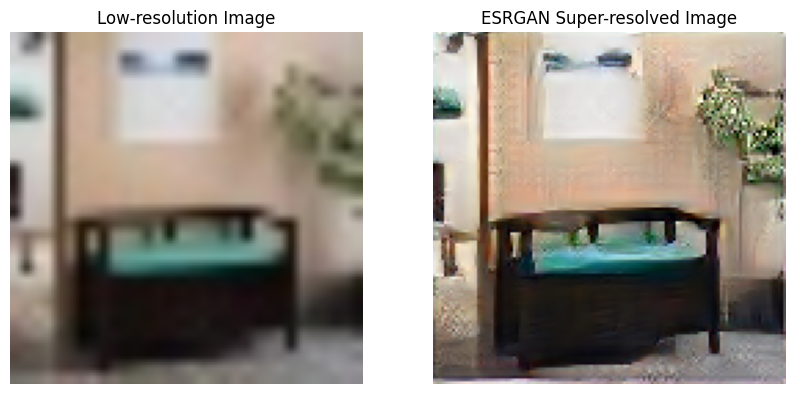

Saved super-resolved image 13 to msrgan_super_res_images\super_res_image_12.png


Processing images:  16%|██████████▏                                                    | 13/80 [00:02<00:12,  5.42it/s]

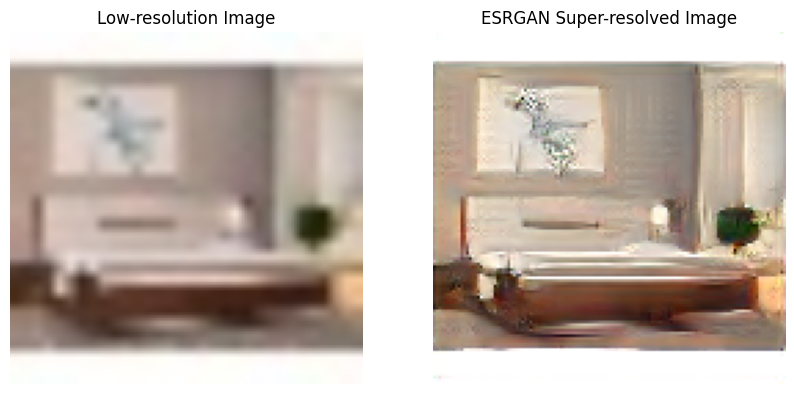

Processing images:  18%|███████████                                                    | 14/80 [00:02<00:11,  5.51it/s]

Saved super-resolved image 14 to msrgan_super_res_images\super_res_image_13.png


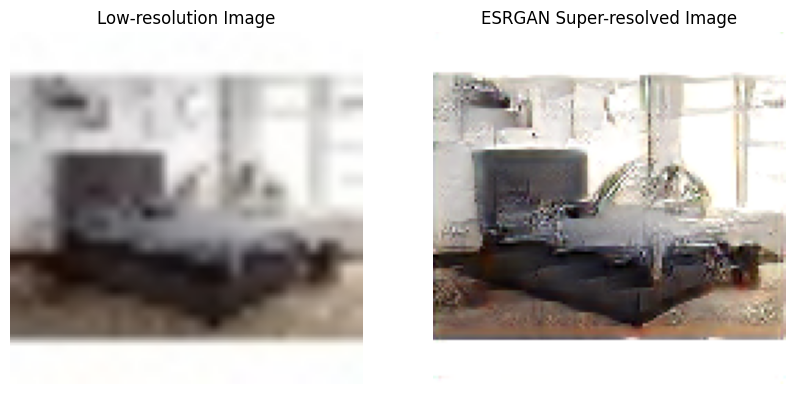

Processing images:  19%|███████████▊                                                   | 15/80 [00:02<00:11,  5.61it/s]

Saved super-resolved image 15 to msrgan_super_res_images\super_res_image_14.png


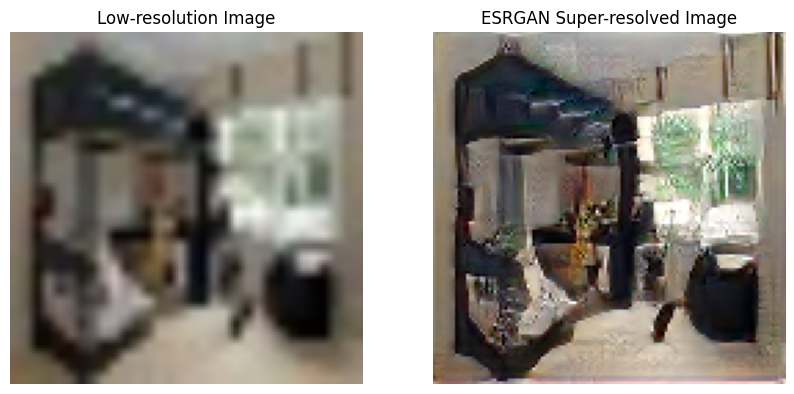

Processing images:  20%|████████████▌                                                  | 16/80 [00:02<00:11,  5.39it/s]

Saved super-resolved image 16 to msrgan_super_res_images\super_res_image_15.png


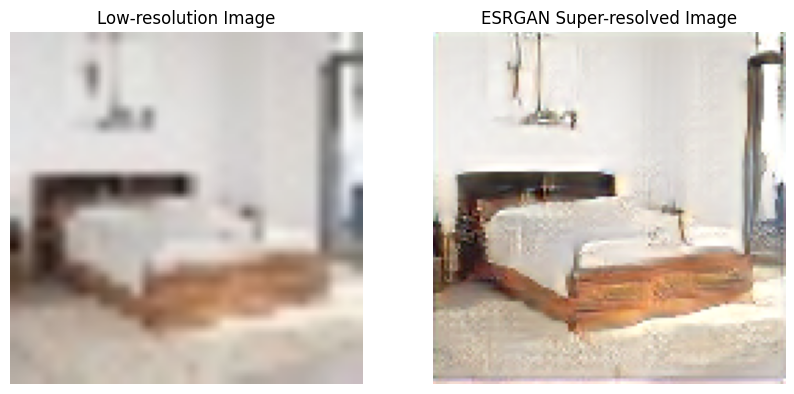

Processing images:  21%|█████████████▍                                                 | 17/80 [00:03<00:14,  4.23it/s]

Saved super-resolved image 17 to msrgan_super_res_images\super_res_image_16.png


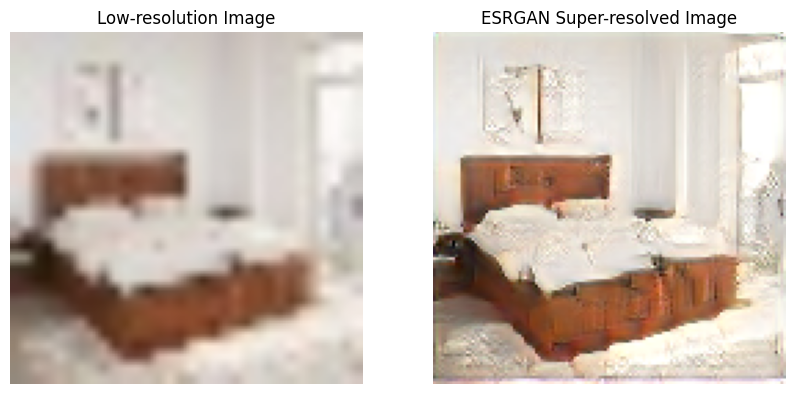

Saved super-resolved image 18 to msrgan_super_res_images\super_res_image_17.png

Processing images:  22%|██████████████▏                                                | 18/80 [00:03<00:13,  4.51it/s]

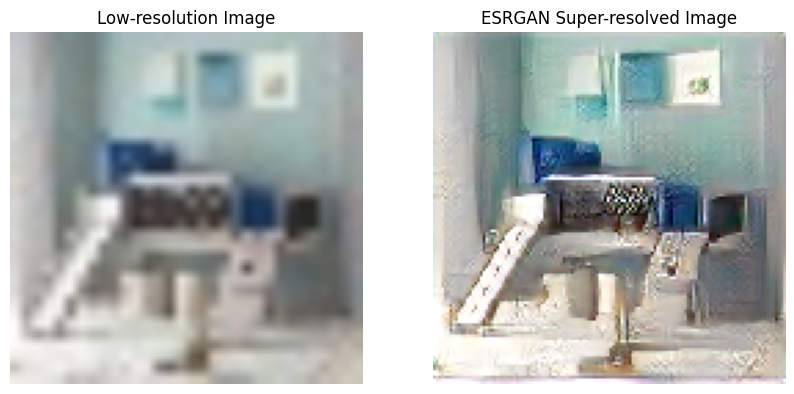

Processing images:  24%|██████████████▉                                                | 19/80 [00:03<00:13,  4.64it/s]

Saved super-resolved image 19 to msrgan_super_res_images\super_res_image_18.png


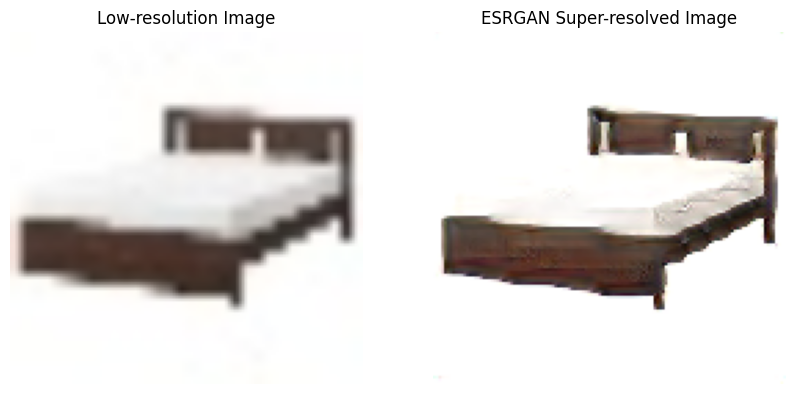

Processing images:  25%|███████████████▊                                               | 20/80 [00:03<00:11,  5.26it/s]

Saved super-resolved image 20 to msrgan_super_res_images\super_res_image_19.png


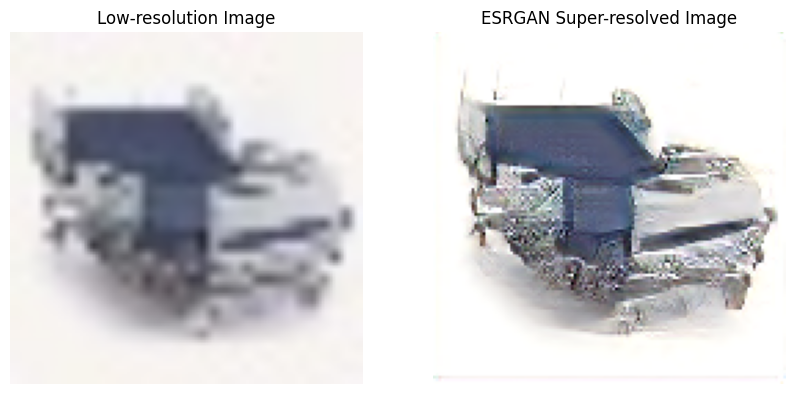

Processing images:  26%|████████████████▌                                              | 21/80 [00:04<00:10,  5.52it/s]

Saved super-resolved image 21 to msrgan_super_res_images\super_res_image_20.png


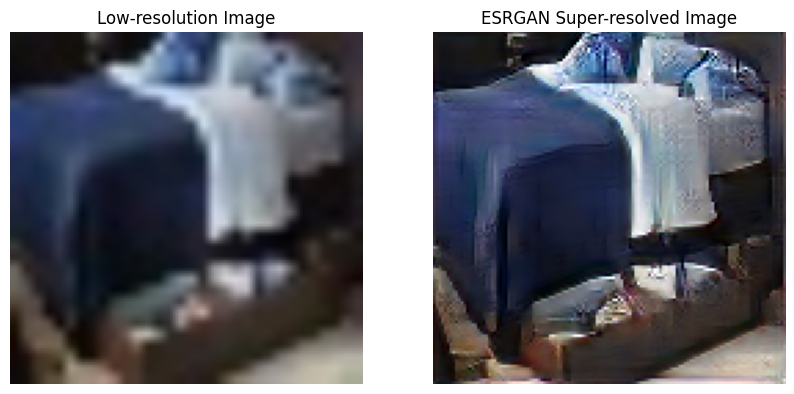

Processing images:  28%|█████████████████▎                                             | 22/80 [00:04<00:10,  5.42it/s]

Saved super-resolved image 22 to msrgan_super_res_images\super_res_image_21.png


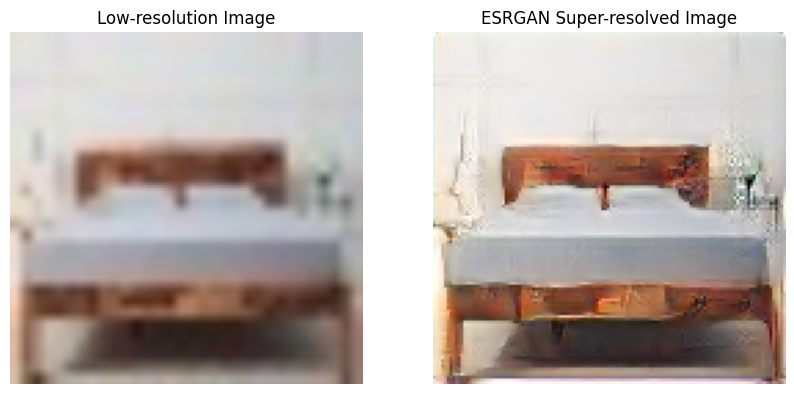

Processing images:  29%|██████████████████                                             | 23/80 [00:04<00:10,  5.40it/s]

Saved super-resolved image 23 to msrgan_super_res_images\super_res_image_22.png


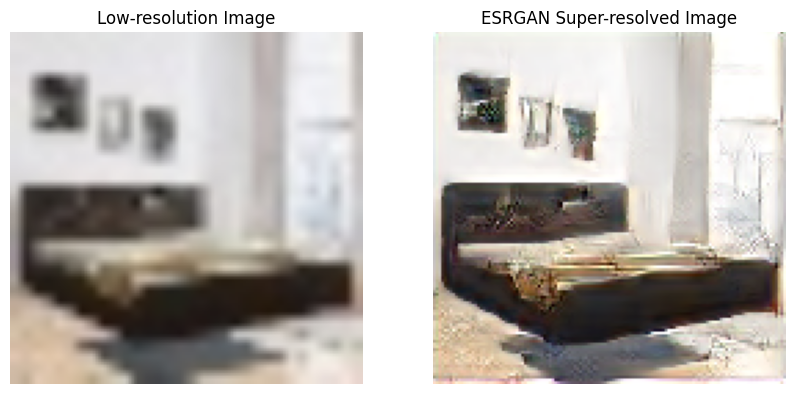

Saved super-resolved image 24 to msrgan_super_res_images\super_res_image_23.png

Processing images:  30%|██████████████████▉                                            | 24/80 [00:04<00:10,  5.43it/s]

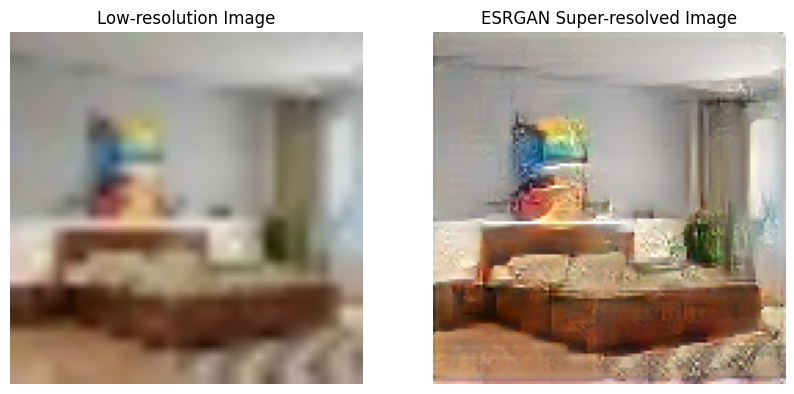

Processing images:  31%|███████████████████▋                                           | 25/80 [00:04<00:10,  5.35it/s]

Saved super-resolved image 25 to msrgan_super_res_images\super_res_image_24.png


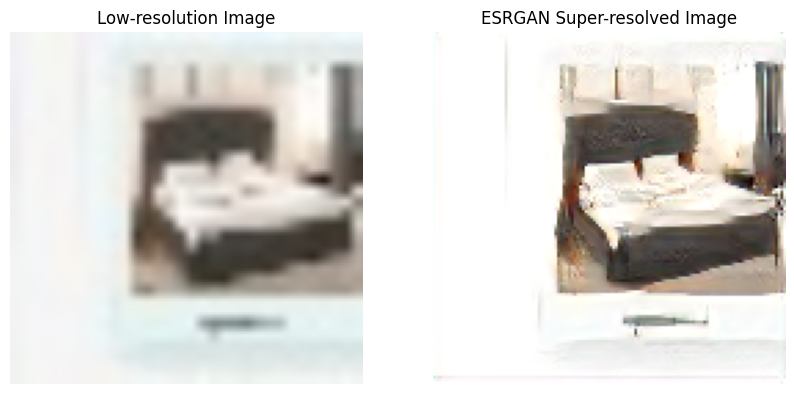

Processing images:  32%|████████████████████▍                                          | 26/80 [00:04<00:09,  5.57it/s]

Saved super-resolved image 26 to msrgan_super_res_images\super_res_image_25.png


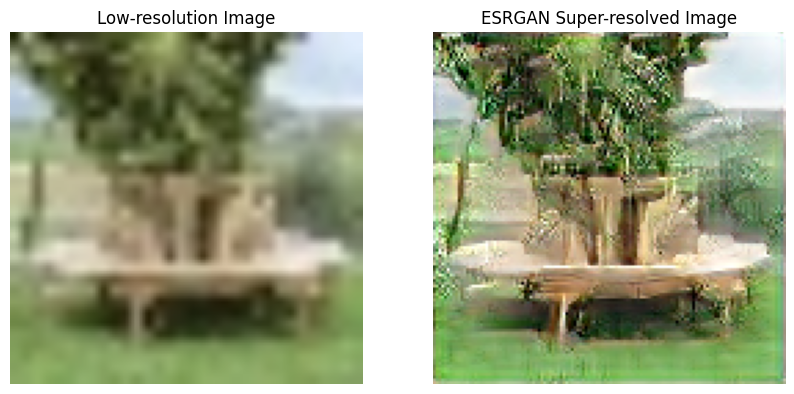

Processing images:  34%|█████████████████████▎                                         | 27/80 [00:05<00:10,  5.29it/s]

Saved super-resolved image 27 to msrgan_super_res_images\super_res_image_26.png


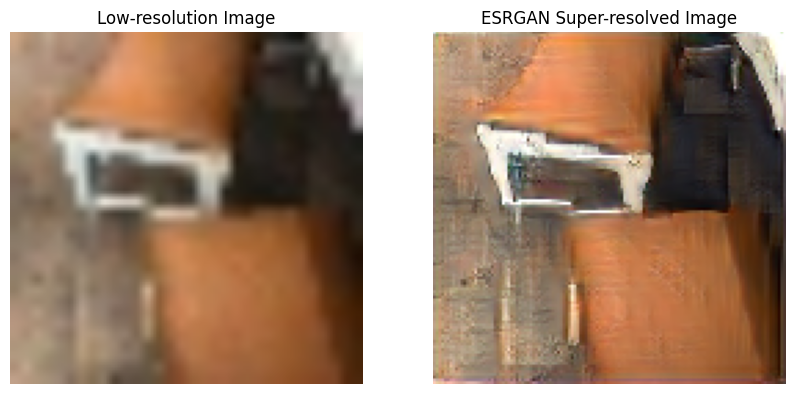

Processing images:  35%|██████████████████████                                         | 28/80 [00:05<00:09,  5.21it/s]

Saved super-resolved image 28 to msrgan_super_res_images\super_res_image_27.png


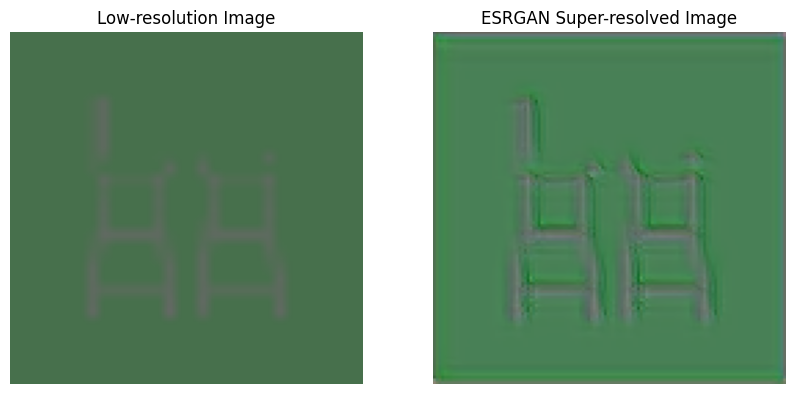

Processing images:  36%|██████████████████████▊                                        | 29/80 [00:05<00:08,  5.87it/s]

Saved super-resolved image 29 to msrgan_super_res_images\super_res_image_28.png


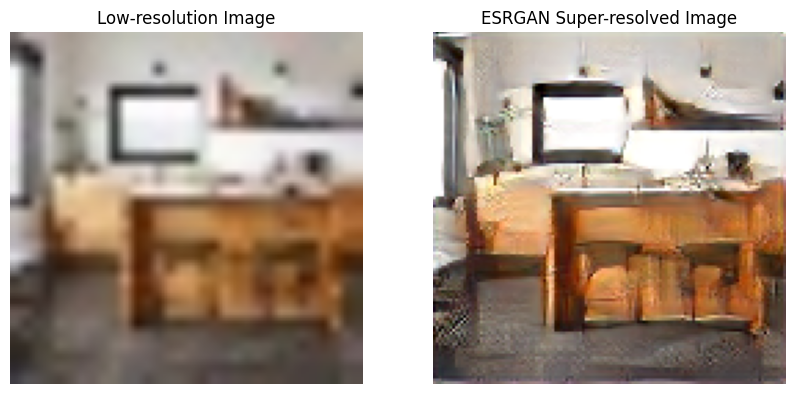

Processing images:  38%|███████████████████████▋                                       | 30/80 [00:05<00:08,  5.60it/s]

Saved super-resolved image 30 to msrgan_super_res_images\super_res_image_29.png


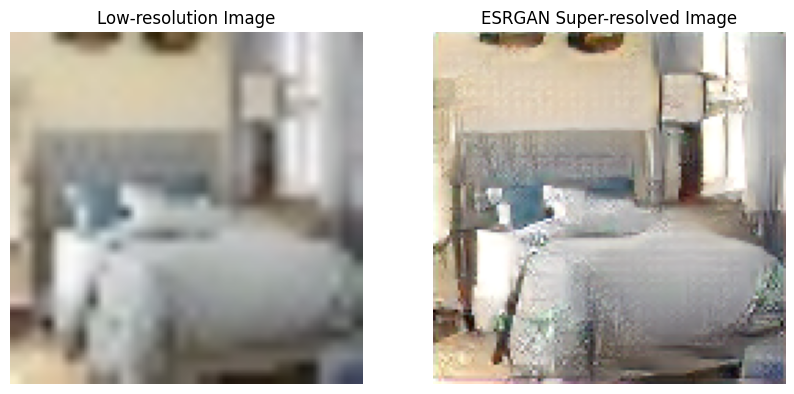

Processing images:  39%|████████████████████████▍                                      | 31/80 [00:05<00:09,  5.42it/s]

Saved super-resolved image 31 to msrgan_super_res_images\super_res_image_30.png


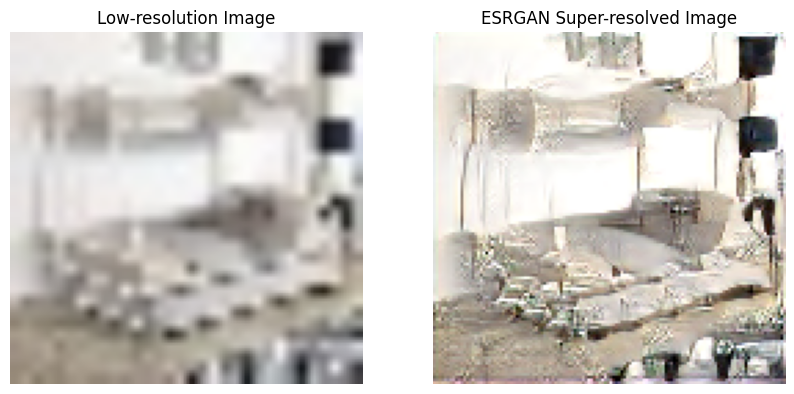

Processing images:  40%|█████████████████████████▏                                     | 32/80 [00:06<00:08,  5.38it/s]

Saved super-resolved image 32 to msrgan_super_res_images\super_res_image_31.png


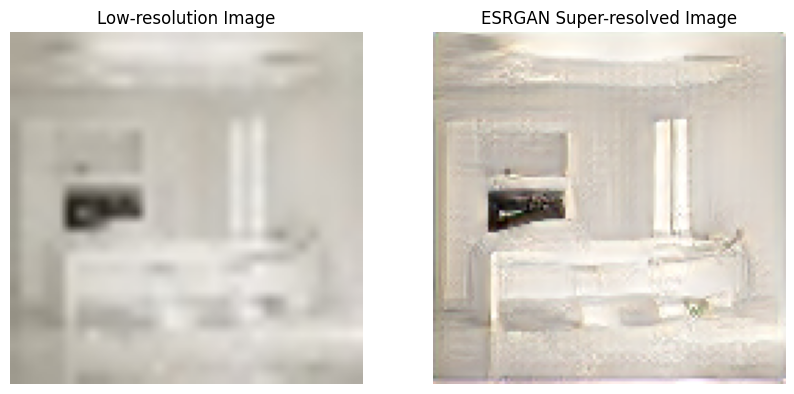

Processing images:  41%|█████████████████████████▉                                     | 33/80 [00:06<00:08,  5.45it/s]

Saved super-resolved image 33 to msrgan_super_res_images\super_res_image_32.png


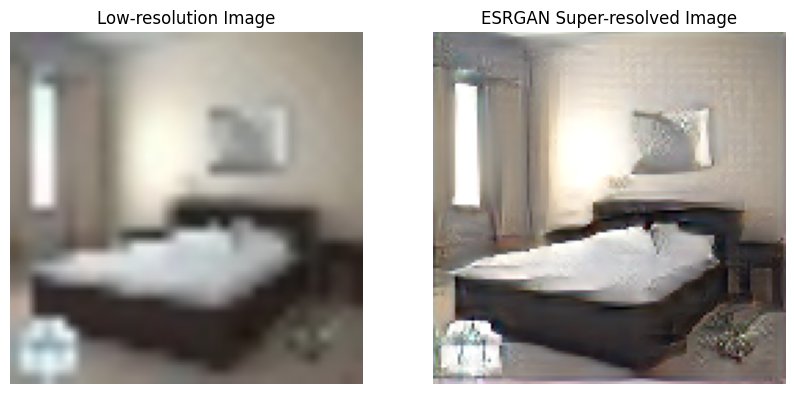

Processing images:  42%|██████████████████████████▊                                    | 34/80 [00:06<00:08,  5.43it/s]

Saved super-resolved image 34 to msrgan_super_res_images\super_res_image_33.png


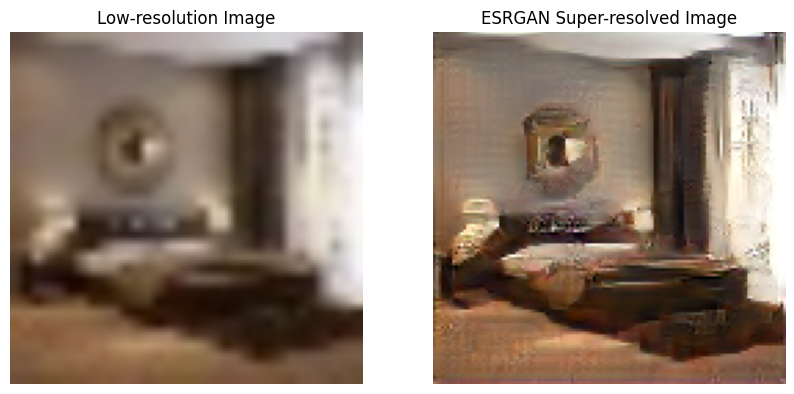

Processing images:  44%|███████████████████████████▌                                   | 35/80 [00:06<00:08,  5.33it/s]

Saved super-resolved image 35 to msrgan_super_res_images\super_res_image_34.png


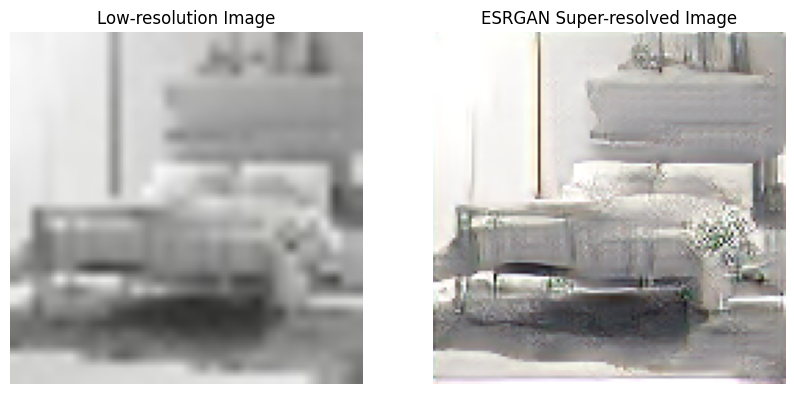

Processing images:  45%|████████████████████████████▎                                  | 36/80 [00:06<00:07,  5.56it/s]

Saved super-resolved image 36 to msrgan_super_res_images\super_res_image_35.png


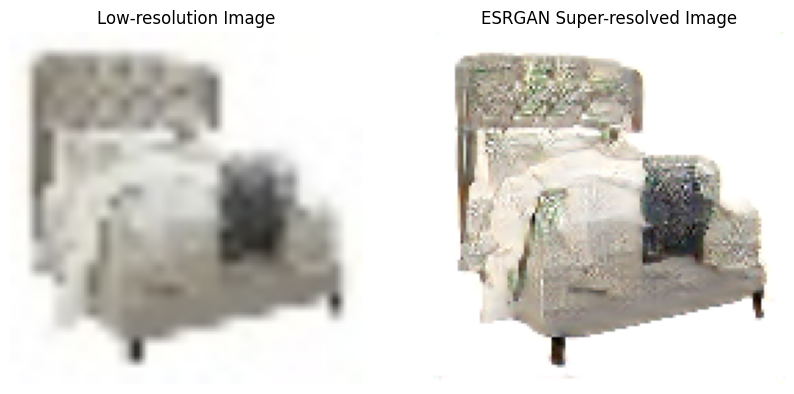

Processing images:  46%|█████████████████████████████▏                                 | 37/80 [00:06<00:07,  5.82it/s]

Saved super-resolved image 37 to msrgan_super_res_images\super_res_image_36.png


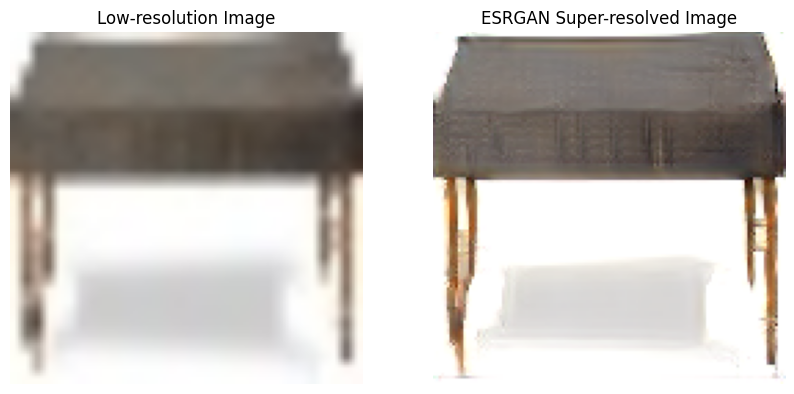

Processing images:  48%|█████████████████████████████▉                                 | 38/80 [00:07<00:06,  6.06it/s]

Saved super-resolved image 38 to msrgan_super_res_images\super_res_image_37.png


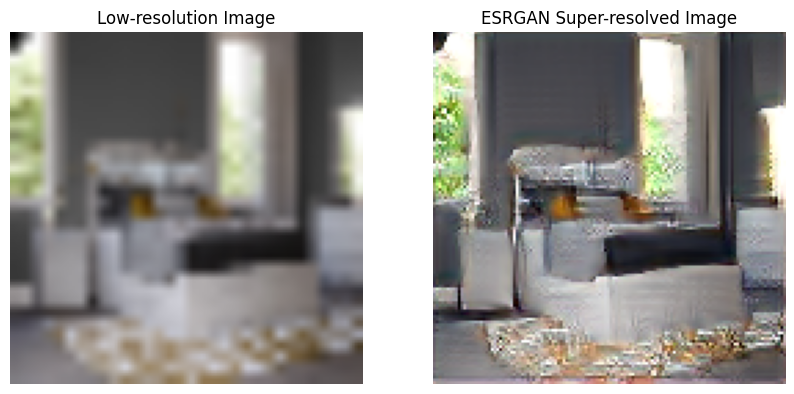

Processing images:  49%|██████████████████████████████▋                                | 39/80 [00:07<00:06,  5.87it/s]

Saved super-resolved image 39 to msrgan_super_res_images\super_res_image_38.png


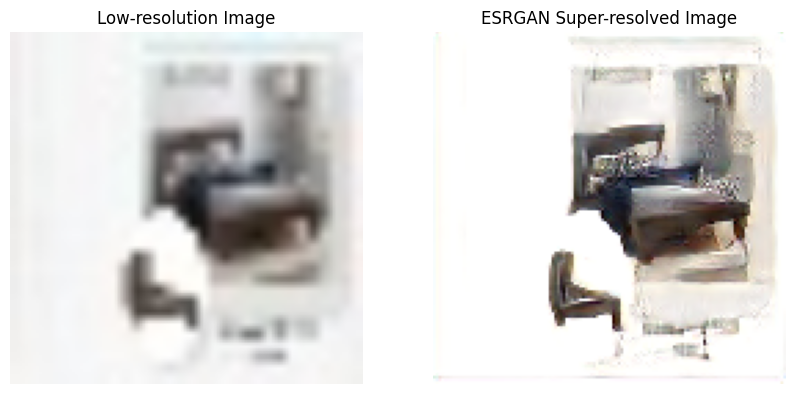

Processing images:  50%|███████████████████████████████▌                               | 40/80 [00:07<00:06,  6.10it/s]

Saved super-resolved image 40 to msrgan_super_res_images\super_res_image_39.png


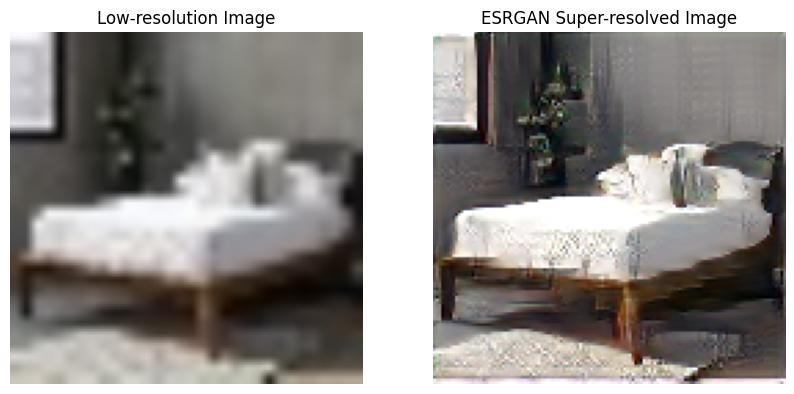

Processing images:  51%|████████████████████████████████▎                              | 41/80 [00:07<00:08,  4.60it/s]

Saved super-resolved image 41 to msrgan_super_res_images\super_res_image_40.png


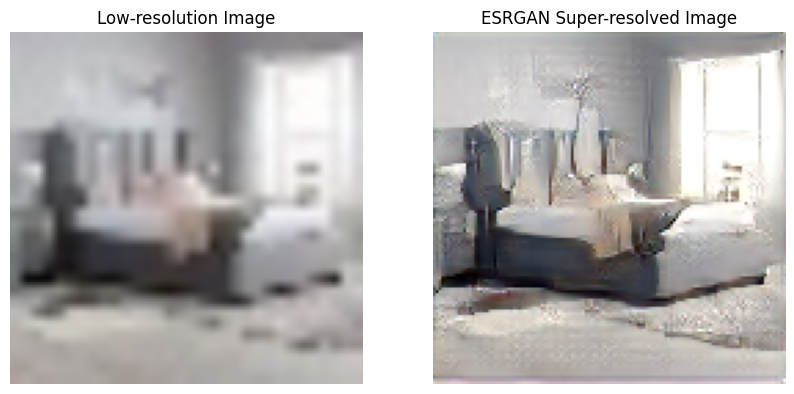

Saved super-resolved image 42 to msrgan_super_res_images\super_res_image_41.png

Processing images:  52%|█████████████████████████████████                              | 42/80 [00:07<00:07,  4.80it/s]

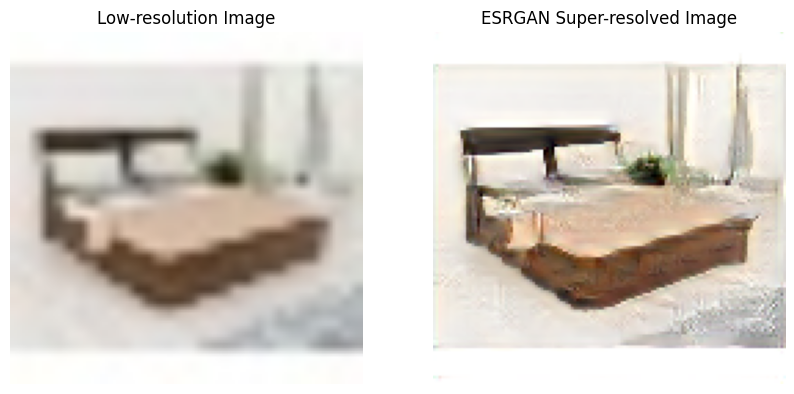

Processing images:  54%|█████████████████████████████████▊                             | 43/80 [00:08<00:07,  5.12it/s]

Saved super-resolved image 43 to msrgan_super_res_images\super_res_image_42.png


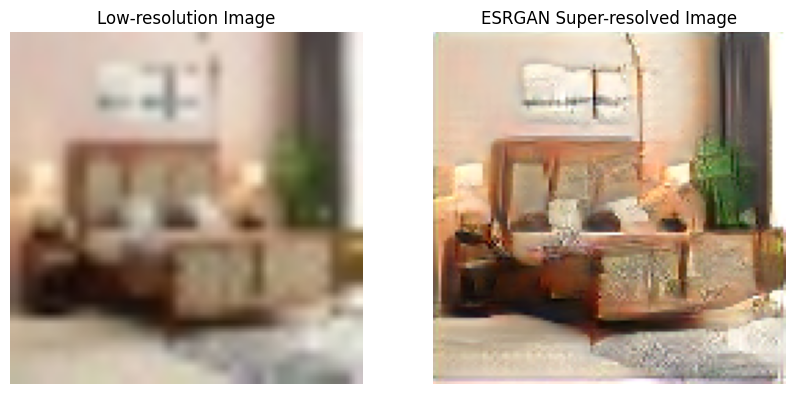

Processing images:  55%|██████████████████████████████████▋                            | 44/80 [00:08<00:07,  5.13it/s]

Saved super-resolved image 44 to msrgan_super_res_images\super_res_image_43.png


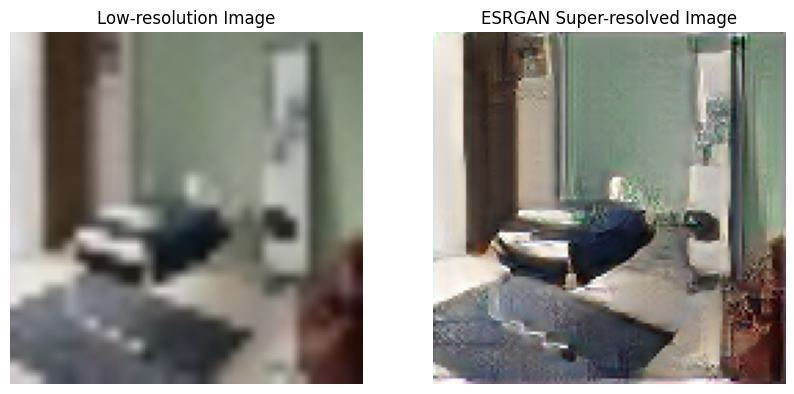

Processing images:  56%|███████████████████████████████████▍                           | 45/80 [00:08<00:06,  5.21it/s]

Saved super-resolved image 45 to msrgan_super_res_images\super_res_image_44.png


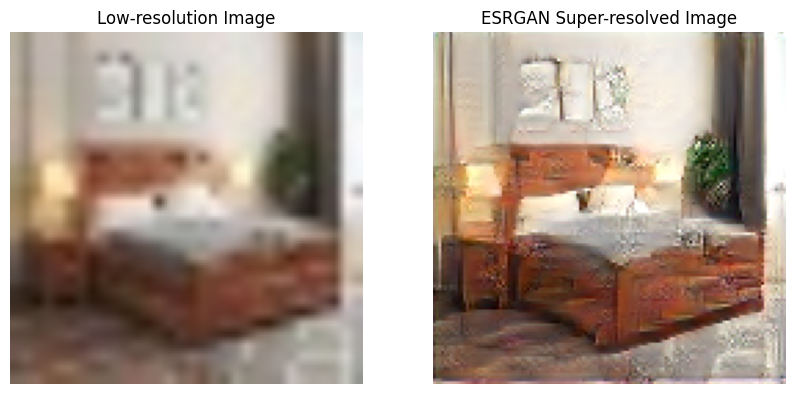

Processing images:  57%|████████████████████████████████████▏                          | 46/80 [00:08<00:06,  5.14it/s]

Saved super-resolved image 46 to msrgan_super_res_images\super_res_image_45.png


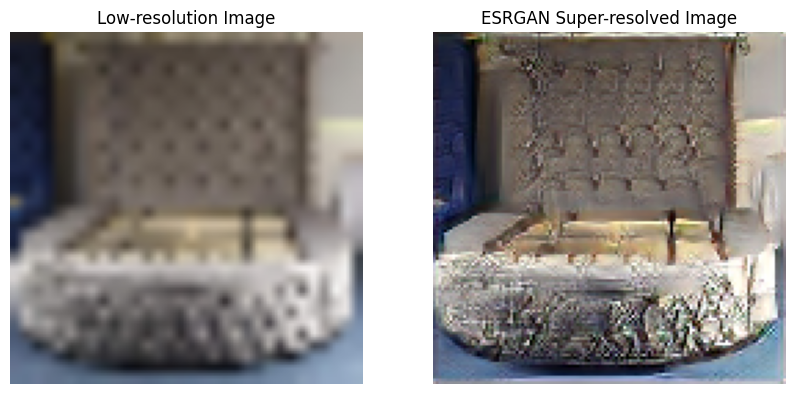

Processing images:  59%|█████████████████████████████████████                          | 47/80 [00:08<00:06,  5.06it/s]

Saved super-resolved image 47 to msrgan_super_res_images\super_res_image_46.png


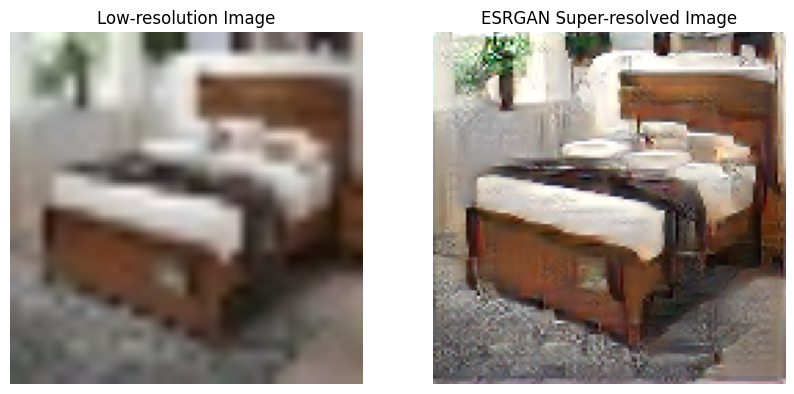

Processing images:  60%|█████████████████████████████████████▊                         | 48/80 [00:09<00:06,  5.02it/s]

Saved super-resolved image 48 to msrgan_super_res_images\super_res_image_47.png


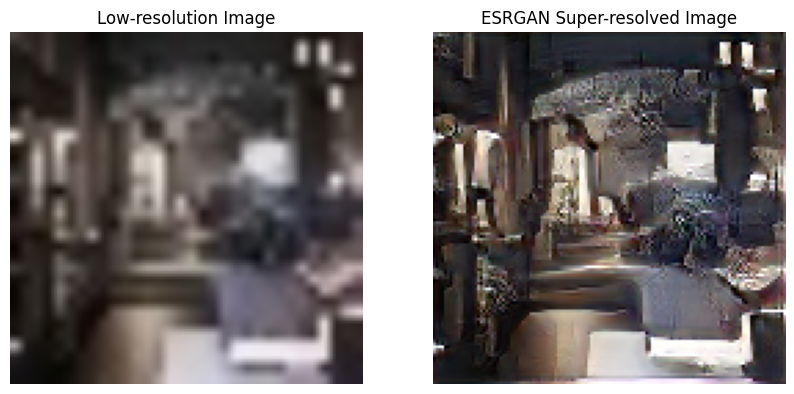

Processing images:  61%|██████████████████████████████████████▌                        | 49/80 [00:09<00:06,  4.99it/s]

Saved super-resolved image 49 to msrgan_super_res_images\super_res_image_48.png


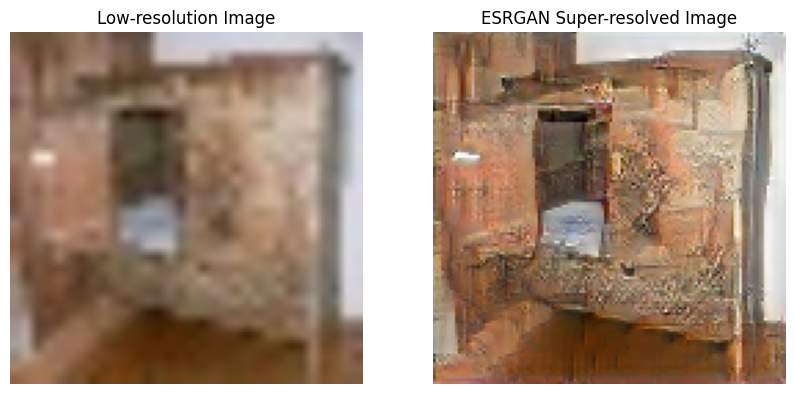

Processing images:  62%|███████████████████████████████████████▍                       | 50/80 [00:09<00:06,  4.84it/s]

Saved super-resolved image 50 to msrgan_super_res_images\super_res_image_49.png


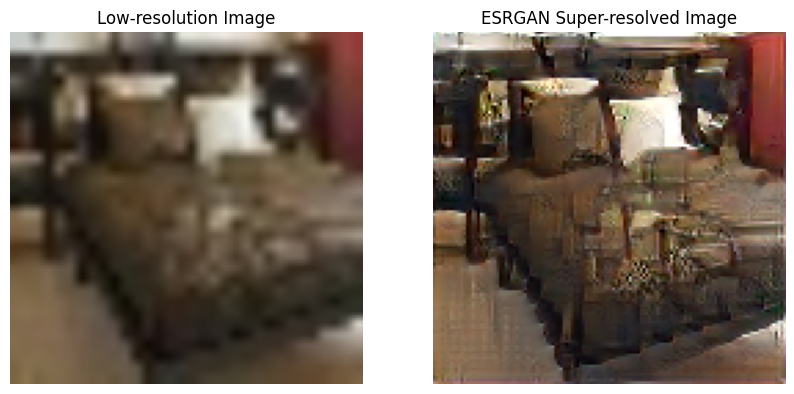

Processing images:  64%|████████████████████████████████████████▏                      | 51/80 [00:09<00:06,  4.81it/s]

Saved super-resolved image 51 to msrgan_super_res_images\super_res_image_50.png


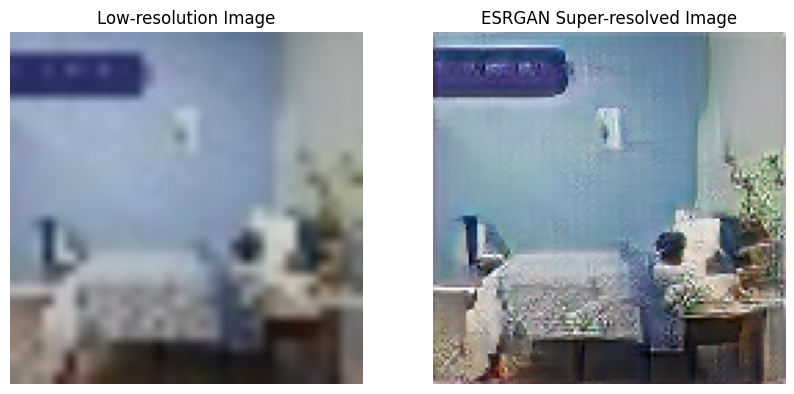

Processing images:  65%|████████████████████████████████████████▉                      | 52/80 [00:09<00:05,  4.92it/s]

Saved super-resolved image 52 to msrgan_super_res_images\super_res_image_51.png


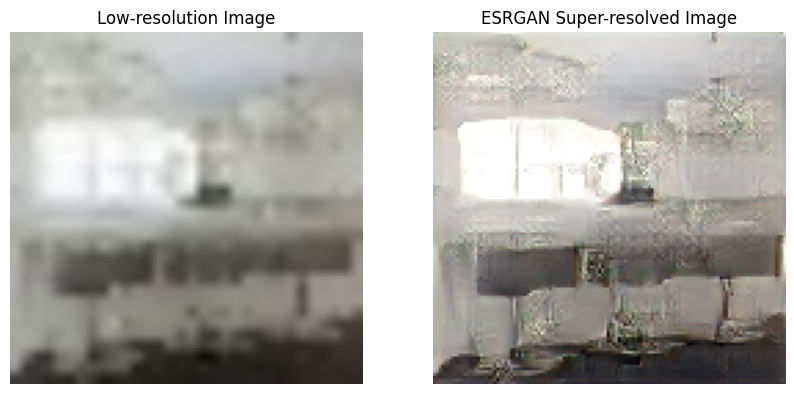

Saved super-resolved image 53 to msrgan_super_res_images\super_res_image_52.png

Processing images:  66%|█████████████████████████████████████████▋                     | 53/80 [00:10<00:05,  5.09it/s]

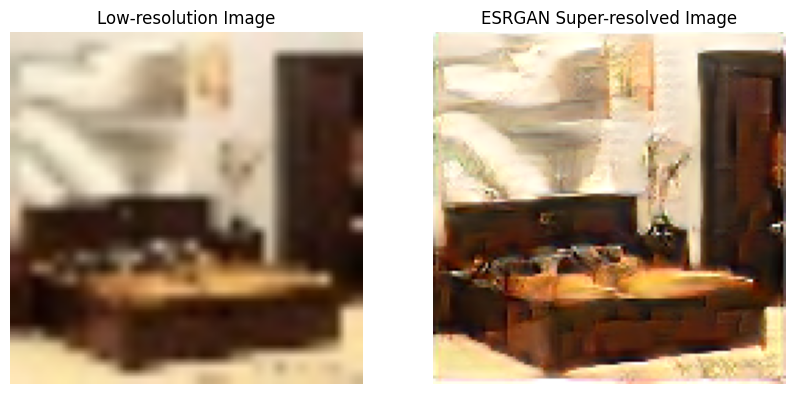

Processing images:  68%|██████████████████████████████████████████▌                    | 54/80 [00:10<00:05,  5.07it/s]

Saved super-resolved image 54 to msrgan_super_res_images\super_res_image_53.png


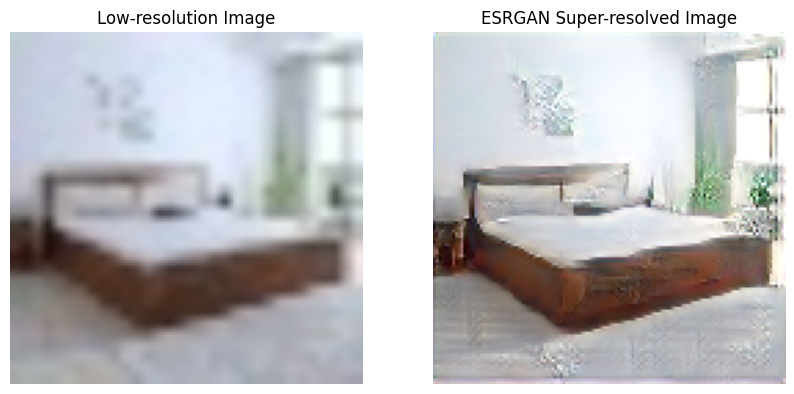

Processing images:  69%|███████████████████████████████████████████▎                   | 55/80 [00:10<00:04,  5.22it/s]

Saved super-resolved image 55 to msrgan_super_res_images\super_res_image_54.png


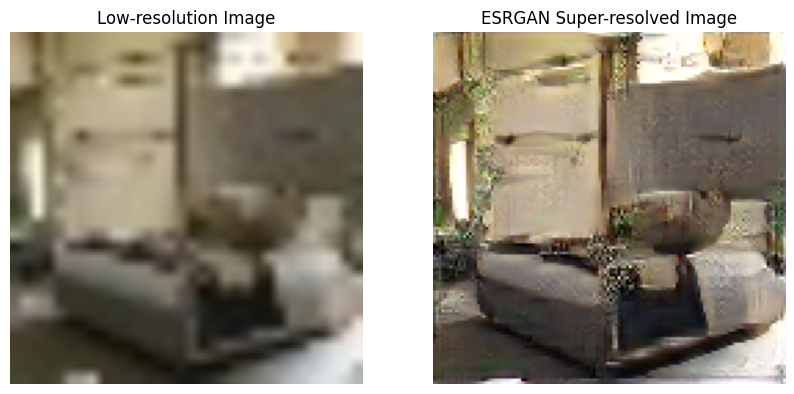

Processing images:  70%|████████████████████████████████████████████                   | 56/80 [00:10<00:04,  5.19it/s]

Saved super-resolved image 56 to msrgan_super_res_images\super_res_image_55.png


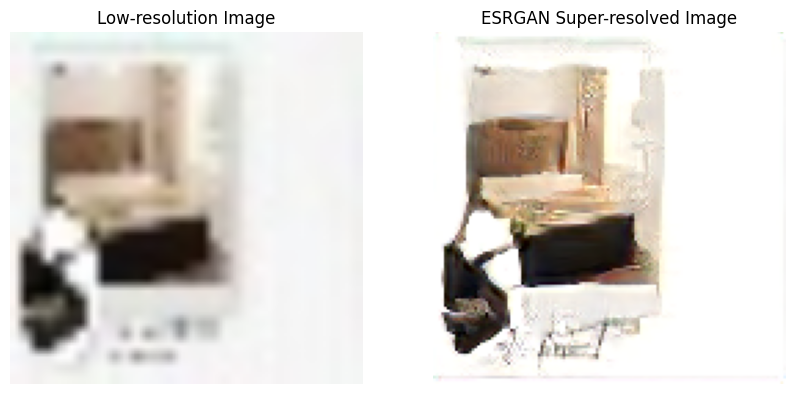

Processing images:  71%|████████████████████████████████████████████▉                  | 57/80 [00:10<00:04,  5.52it/s]

Saved super-resolved image 57 to msrgan_super_res_images\super_res_image_56.png


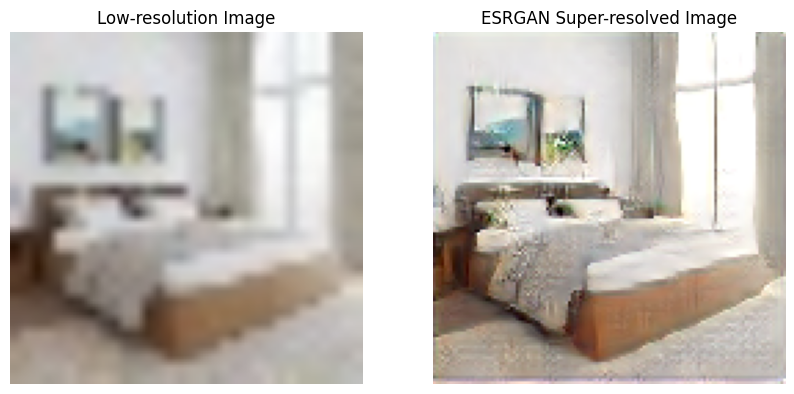

Processing images:  72%|█████████████████████████████████████████████▋                 | 58/80 [00:11<00:04,  5.46it/s]

Saved super-resolved image 58 to msrgan_super_res_images\super_res_image_57.png


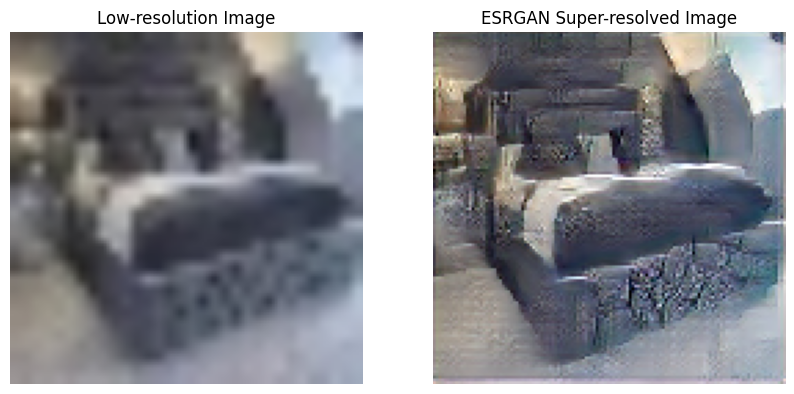

Processing images:  74%|██████████████████████████████████████████████▍                | 59/80 [00:11<00:03,  5.32it/s]

Saved super-resolved image 59 to msrgan_super_res_images\super_res_image_58.png


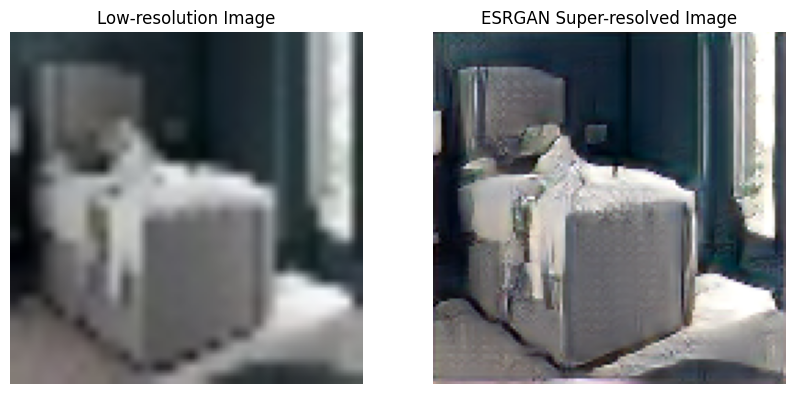

Saved super-resolved image 60 to msrgan_super_res_images\super_res_image_59.png

Processing images:  75%|███████████████████████████████████████████████▎               | 60/80 [00:11<00:03,  5.35it/s]

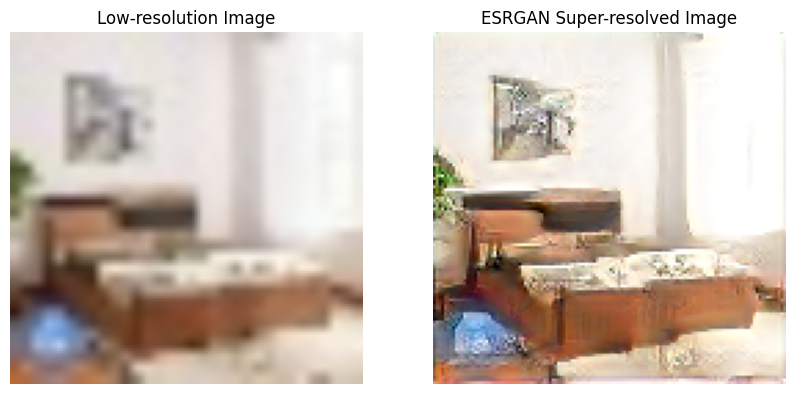

Saved super-resolved image 61 to msrgan_super_res_images\super_res_image_60.png


Processing images:  76%|████████████████████████████████████████████████               | 61/80 [00:11<00:03,  5.39it/s]

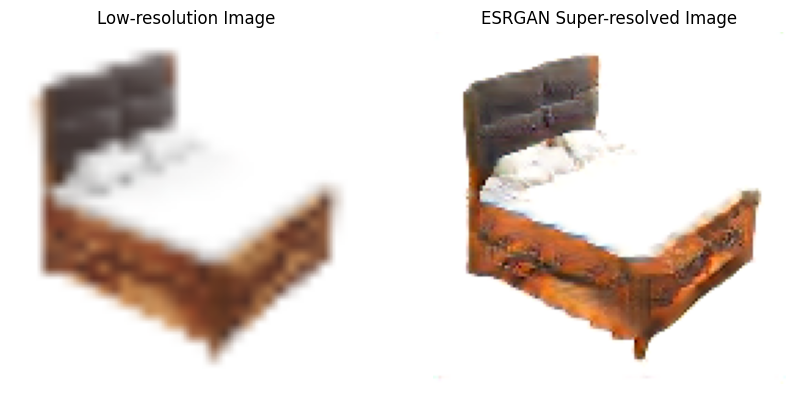

Processing images:  78%|████████████████████████████████████████████████▊              | 62/80 [00:11<00:03,  5.86it/s]

Saved super-resolved image 62 to msrgan_super_res_images\super_res_image_61.png


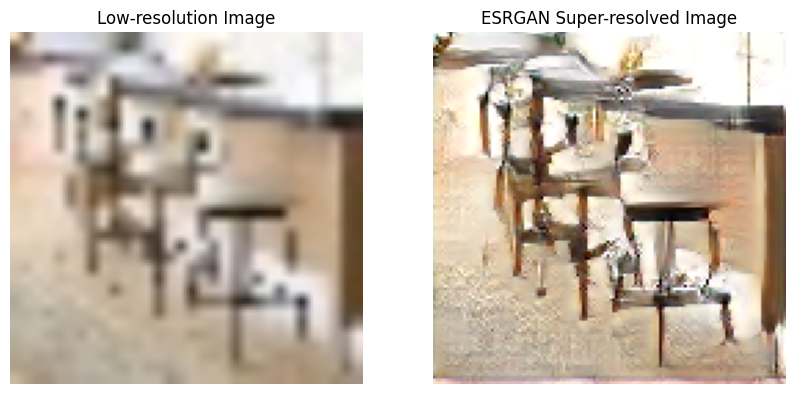

Processing images:  79%|█████████████████████████████████████████████████▌             | 63/80 [00:11<00:03,  5.49it/s]

Saved super-resolved image 63 to msrgan_super_res_images\super_res_image_62.png


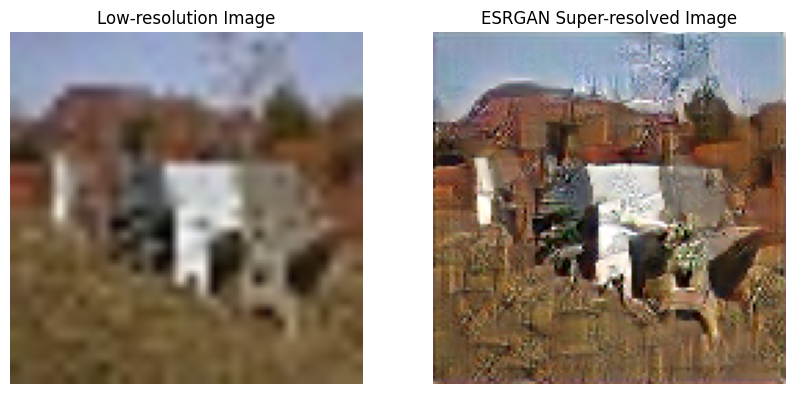

Processing images:  80%|██████████████████████████████████████████████████▍            | 64/80 [00:12<00:03,  5.32it/s]

Saved super-resolved image 64 to msrgan_super_res_images\super_res_image_63.png


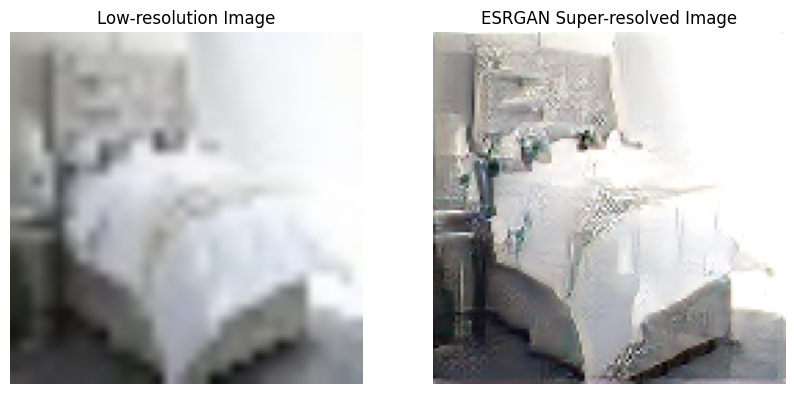

Processing images:  81%|███████████████████████████████████████████████████▏           | 65/80 [00:12<00:02,  5.42it/s]

Saved super-resolved image 65 to msrgan_super_res_images\super_res_image_64.png


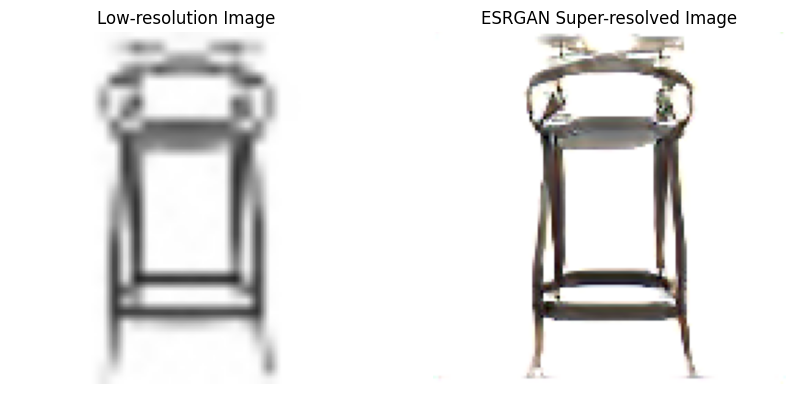

Processing images:  82%|███████████████████████████████████████████████████▉           | 66/80 [00:12<00:02,  6.12it/s]

Saved super-resolved image 66 to msrgan_super_res_images\super_res_image_65.png


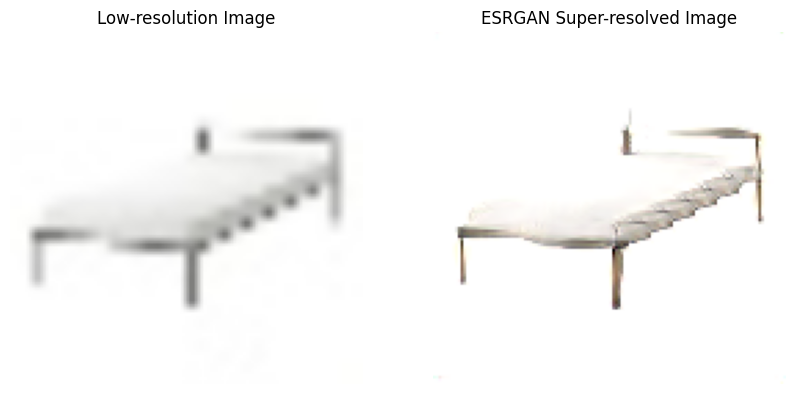

Processing images:  84%|████████████████████████████████████████████████████▊          | 67/80 [00:12<00:02,  5.09it/s]

Saved super-resolved image 67 to msrgan_super_res_images\super_res_image_66.png


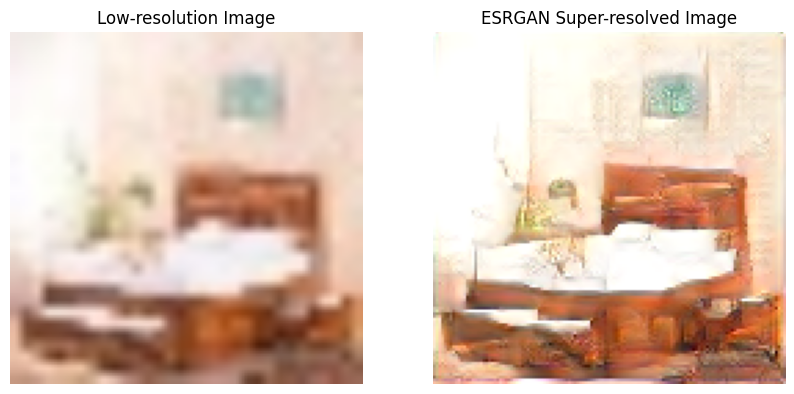

Processing images:  85%|█████████████████████████████████████████████████████▌         | 68/80 [00:12<00:02,  5.12it/s]

Saved super-resolved image 68 to msrgan_super_res_images\super_res_image_67.png


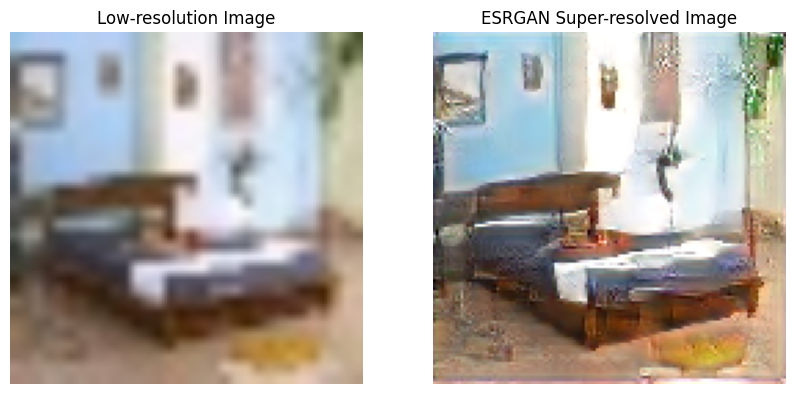

Processing images:  86%|██████████████████████████████████████████████████████▎        | 69/80 [00:13<00:02,  5.06it/s]

Saved super-resolved image 69 to msrgan_super_res_images\super_res_image_68.png


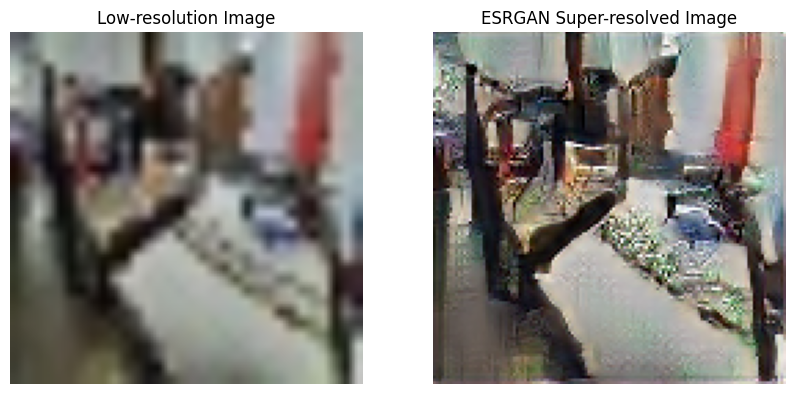

Processing images:  88%|███████████████████████████████████████████████████████▏       | 70/80 [00:13<00:02,  4.95it/s]

Saved super-resolved image 70 to msrgan_super_res_images\super_res_image_69.png


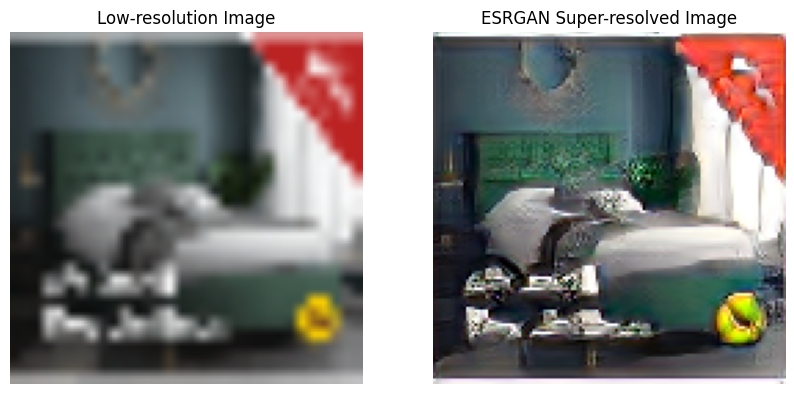

Saved super-resolved image 71 to msrgan_super_res_images\super_res_image_70.png

Processing images:  89%|███████████████████████████████████████████████████████▉       | 71/80 [00:13<00:01,  5.06it/s]

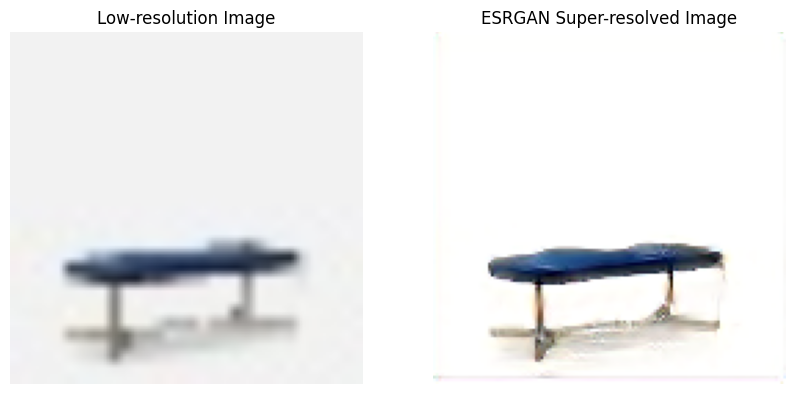

Processing images:  90%|████████████████████████████████████████████████████████▋      | 72/80 [00:13<00:01,  5.74it/s]

Saved super-resolved image 72 to msrgan_super_res_images\super_res_image_71.png


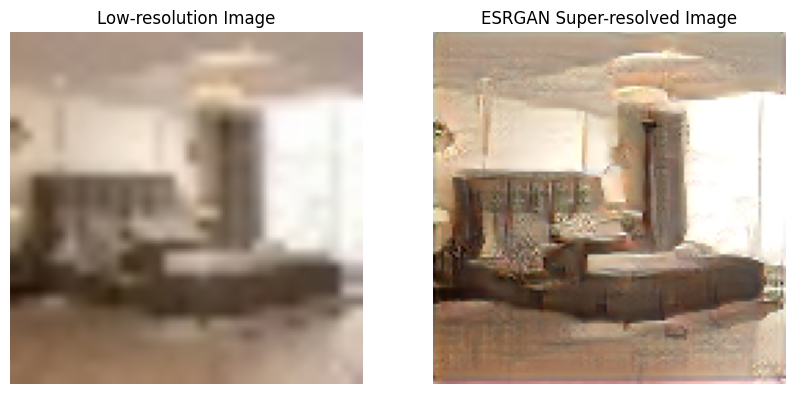

Processing images:  91%|█████████████████████████████████████████████████████████▍     | 73/80 [00:13<00:01,  5.64it/s]

Saved super-resolved image 73 to msrgan_super_res_images\super_res_image_72.png


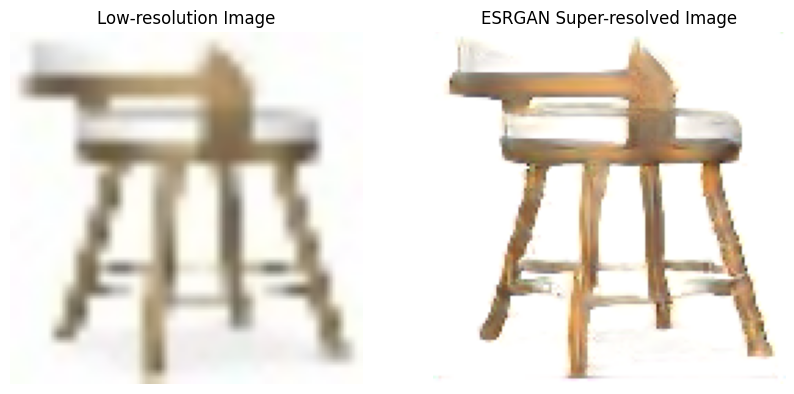

Processing images:  92%|██████████████████████████████████████████████████████████▎    | 74/80 [00:13<00:01,  5.89it/s]

Saved super-resolved image 74 to msrgan_super_res_images\super_res_image_73.png


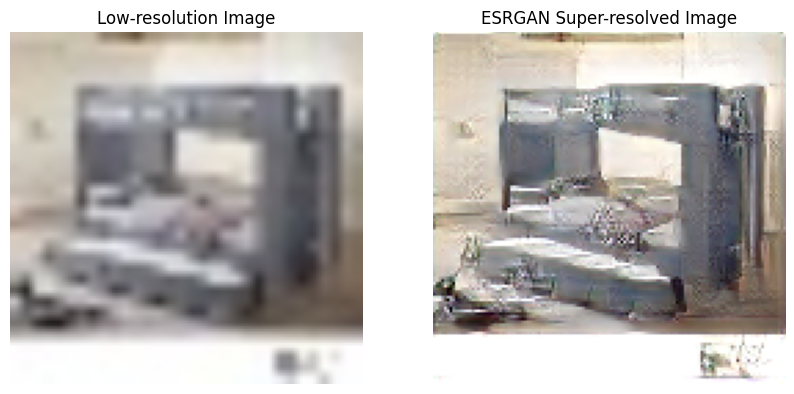

Saved super-resolved image 75 to msrgan_super_res_images\super_res_image_74.png

Processing images:  94%|███████████████████████████████████████████████████████████    | 75/80 [00:14<00:00,  5.74it/s]

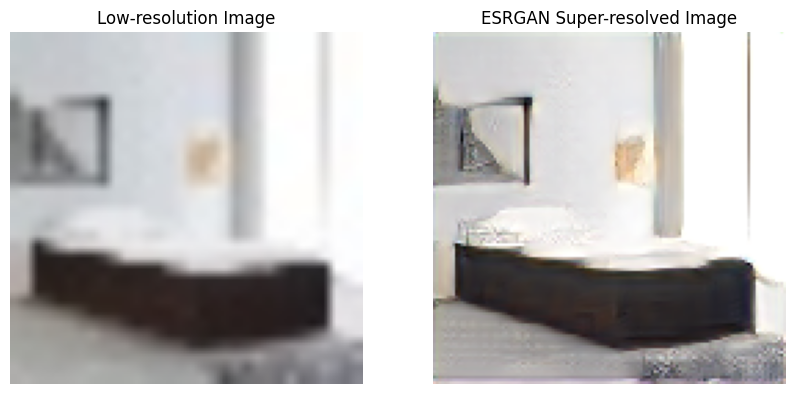

Processing images:  95%|███████████████████████████████████████████████████████████▊   | 76/80 [00:14<00:00,  5.98it/s]

Saved super-resolved image 76 to msrgan_super_res_images\super_res_image_75.png


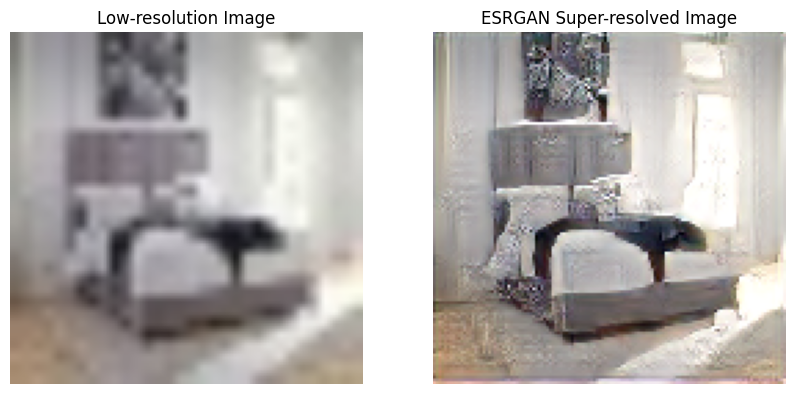

Processing images:  96%|████████████████████████████████████████████████████████████▋  | 77/80 [00:14<00:00,  5.73it/s]

Saved super-resolved image 77 to msrgan_super_res_images\super_res_image_76.png


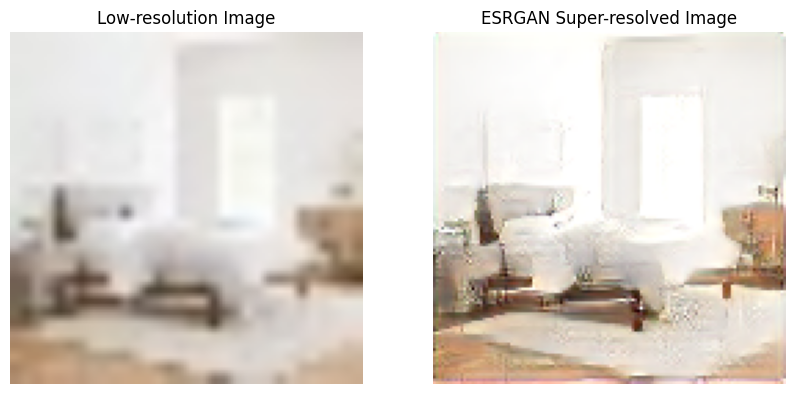

Processing images:  98%|█████████████████████████████████████████████████████████████▍ | 78/80 [00:14<00:00,  5.76it/s]

Saved super-resolved image 78 to msrgan_super_res_images\super_res_image_77.png


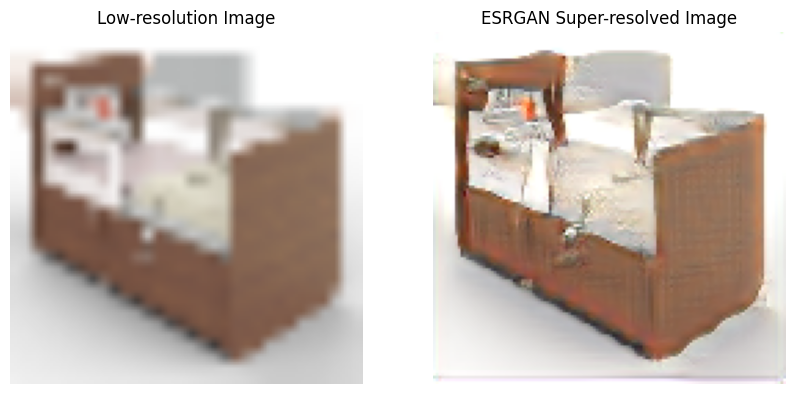

Processing images:  99%|██████████████████████████████████████████████████████████████▏| 79/80 [00:14<00:00,  5.79it/s]

Saved super-resolved image 79 to msrgan_super_res_images\super_res_image_78.png


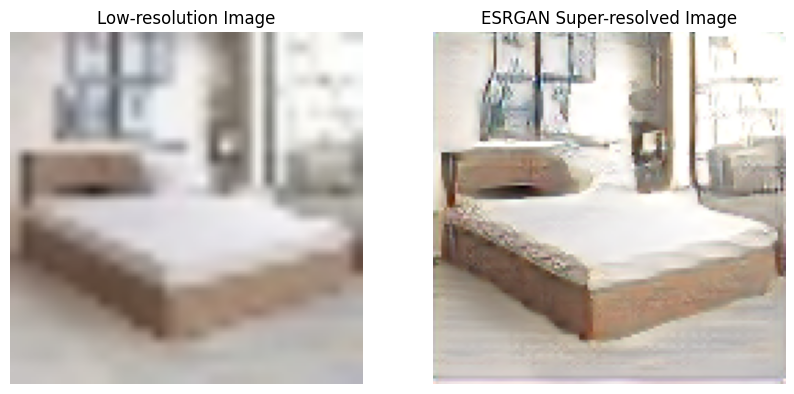

Processing images: 100%|███████████████████████████████████████████████████████████████| 80/80 [00:14<00:00,  5.34it/s]

Saved super-resolved image 80 to msrgan_super_res_images\super_res_image_79.png


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
def sample_super_resolution(generator, val_loader, save_folder='msrgan_super_res_images', num_samples=400):
    generator.eval()

    # Create save folder if it doesn't exist
    if not os.path.exists(save_folder):
        os.makedirs(save_folder)

    device = next(generator.parameters()).device
    with torch.no_grad():
        for i, (high_res_img, low_res_img) in tqdm(enumerate(test_loader), total=len(test_loader), desc="Processing images"):
            if i >= num_samples:
                break
            high_res_img, low_res_img = high_res_img.to(device), low_res_img.to(device)
            fake_hr_img = generator(low_res_img)


            low_res_np = low_res_img.squeeze().permute(1, 2, 0).cpu().numpy()
            fake_hr_np = fake_hr_img.squeeze().permute(1, 2, 0).cpu().numpy()

            # Clip to range [0, 1] and convert to [0, 255]
            low_res_np = (np.clip(low_res_np, 0, 1) * 255).astype(np.uint8)
            fake_hr_np = (np.clip(fake_hr_np, 0, 1) * 255).astype(np.uint8)

            # Convert from BGR to RGB if necessary (OpenCV loads images in BGR format)
            low_res_np = cv2.cvtColor(low_res_np, cv2.COLOR_BGR2RGB)
            fake_hr_np = cv2.cvtColor(fake_hr_np, cv2.COLOR_BGR2RGB)

            # Plot images
            plt.figure(figsize=(10, 5))
            plt.subplot(1, 2, 1)
            plt.imshow(low_res_np)
            plt.title('Low-resolution Image')
            plt.axis('off')
            plt.subplot(1, 2, 2)
            plt.imshow(fake_hr_np)
            plt.title('ESRGAN Super-resolved Image')
            plt.axis('off')
            plt.show()

            # Save super-resolved images
            image_name = f'super_res_image_{i}.png'
            save_path = os.path.join(save_folder, image_name)
            plt.imsave(save_path, fake_hr_np)
            print(f'Saved super-resolved image {i+1} to {save_path}')

# Sample super-resolution images and save them
sample_super_resolution(generator, train_loader, save_folder='msrgan_super_res_images', num_samples=400)